<a href="https://colab.research.google.com/github/leksandre/-crab-for-web2ipr_book_shop/blob/main/process_YOLOv9___building_windows_detection_(v3_7)_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# import os
# import time
# from datetime import datetime

# # Define the target dates
# date_photo3 = datetime(2025, 8, 22)
# date_photo4 = datetime(2025, 8, 24)

# # Convert dates to timestamps (seconds since epoch)
# timestamp_photo3 = time.mktime(date_photo3.timetuple())
# timestamp_photo4 = time.mktime(date_photo4.timetuple())

# # File paths
# file_photo3 = '/content/drive/MyDrive/datasets/photo3.jpg'
# file_photo4 = '/content/drive/MyDrive/datasets/photo4.jpg'

# # Change the access and modification time of the files
# # Note: Directly setting creation time is not supported on all file systems.
# # os.utime changes access and modification time, which often influences
# # what is displayed as creation time.
# try:
#     os.utime(file_photo3, (timestamp_photo3, timestamp_photo3))
#     print(f"Access and modification date of {file_photo3} changed to {date_photo3.strftime('%Y-%m-%d')}")
# except FileNotFoundError:
#     print(f"Error: File not found at {file_photo3}")
# except Exception as e:
#     print(f"An error occurred while changing the access and modification date of {file_photo3}: {e}")

# try:
#     os.utime(file_photo4, (timestamp_photo4, timestamp_photo4))
#     print(f"Access and modification date of {file_photo4} changed to {date_photo4.strftime('%Y-%m-%d')}")
# except FileNotFoundError:
#     print(f"Error: File not found at {file_photo4}")
# except Exception as e:
#     print(f"An error occurred while changing the access and modification date of {file_photo4}: {e}")

In [ ]:
!mkdir /content/train
%cd /content/train
!mkdir /content/train/dataset
!mkdir /content/train/backup
!ls /content/train/dataset
!ls -lsaht /content/drive/MyDrive/datasets/

/content/train
total 921M
324K -rw------- 1 root root 324K Sep  1 08:56 photo3.jpg
307K -rw------- 1 root root 307K Sep  1 08:54 photo2_2025-08-14.jpg
344K -rw------- 1 root root 344K Sep  1 08:52 photo4_2025-08-23.jpg
324K -rw------- 1 root root 324K Sep  1 08:52 photo3_2025-08-22.jpg
344K -rw------- 1 root root 344K Sep  1 08:38 photo4.jpg
347K -rw------- 1 root root 347K Sep  1 06:55 photo5_2025-08-29.jpg
304K -rw------- 1 root root 304K Sep  1 06:55 photo6_2025-09-01.jpg
298K -rw------- 1 root root 298K Sep  1 06:54 photoB_2025-09-01.jpg
289K -rw------- 1 root root 289K Sep  1 06:53 photoB_2025-08-29.jpg
270K -rw------- 1 root root 270K Sep  1 06:50 photoB_2025-08-22.jpg
 28M -rw------- 1 root root  28M Aug 17 08:14 windowsYolo9_v4.onnx
 15M -rw------- 1 root root  15M Aug 17 08:14 windowsYolo9_v4.pt
 28M -rw------- 1 root root  28M Aug 15 17:42 windowsYolo9_v3.onnx
 15M -rw------- 1 root root  15M Aug 15 17:42 windowsYolo9_v3.pt
 15M -rw------- 1 root root  15M Aug 15 11:01 window

In [ ]:
import glob

In [ ]:
arch_01 = glob.glob('/content/drive/MyDrive/datasets/buildingYolo9.zip')[0]

In [ ]:
print(arch_01)

/content/drive/MyDrive/datasets/buildingYolo9.zip


In [ ]:
myvar = "/content/train/"
!cd {myvar}

In [ ]:
!cp {arch_01} "/content/train/"

In [ ]:
import os
import os.path

In [ ]:
if os.path.exists(arch_01) or os.path.isfile(arch_01):
  if os.path.isfile(arch_01):
    !unrar x -Y {arch_01} "/content/train/dataset"
    !unzip {arch_01} -d "/content/train/dataset"

Выходные данные были обрезаны до нескольких последних строк (5000).
 extracting: /content/train/dataset/train/images/21387_jpg.rf.a756f3657aa053787ea44a0f482aaef7.jpg  
 extracting: /content/train/dataset/train/images/2144_jpg.rf.318d510e6d95a5b7e114b340793068c3.jpg  
 extracting: /content/train/dataset/train/images/21461_jpg.rf.a5bcc293ebb6e207cdfbdc0321203f4c.jpg  
 extracting: /content/train/dataset/train/images/21485_jpg.rf.97a595b5ca14077340cd81e871cbb7ae.jpg  
 extracting: /content/train/dataset/train/images/21581_jpg.rf.a88c84215f6548631e7dff25bcd946d2.jpg  
 extracting: /content/train/dataset/train/images/21597_jpg.rf.1669998a74a6325338fe594204e93a12.jpg  
 extracting: /content/train/dataset/train/images/21621_jpg.rf.66581611e0e41e7400213376e2f76ceb.jpg  
 extracting: /content/train/dataset/train/images/21648_jpg.rf.902e729fe463e7f51f9adc5285ccde3f.jpg  
 extracting: /content/train/dataset/train/images/21706_jpg.rf.41a10ac8a7b4d1f6c8b3f544f1d7d04d.jpg  
 extracting: /content/tr

In [ ]:
TRAIN_IMAGE_PATH = '/content/train/dataset/train/'
TEST_IMAGE_PATH = '/content/train/dataset/test/'
VAL_IMAGE_PATH = '/content/train/dataset/valid/'

In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
snehilsanyal_construction_site_safety_image_dataset_roboflow_path = kagglehub.dataset_download('snehilsanyal/construction-site-safety-image-dataset-roboflow')

print('Data source import complete.')


Data source import complete.


# About

- In this notebook I will train Yolo v9 model to detect PPE (Personal Protective Equipment), using [this existing dataset](https://www.kaggle.com/datasets/snehilsanyal/construction-site-safety-image-dataset-roboflow) from [Roboflow](https://universe.roboflow.com/)
- In the [next notebook](https://www.kaggle.com/hinepo/yolov9-inference-for-red-zone-application) I will use this custom model to make inference on videos and post-process the results so they can be used in a Red Zone/Trespassing detection application
- This notebook is a generic training pipeline that you can use to train any Yolo model for object detection task on any dataset (images/number of classes), as long as you provide the dataset in the correct folder structure accepted by Yolo and the annotations/labels in Yolo format
- [Ultralytics - docs](https://docs.ultralytics.com/)
- [Ultralytics - github](https://github.com/ultralytics/ultralytics)

___

[CSS (Construction Site Safety) Dataset](https://www.kaggle.com/datasets/snehilsanyal/construction-site-safety-image-dataset-roboflow):

- Labels in this dataset:
    - 0: Window


- More info:
    - Number of classes: 10
    - Label Annotation: YOLO format (.txt)
      - `[class_id, center_x, center_y, width, height]`
      
___      

Yolo Dataset folder structure: the paths to these folders will be written to a YAML file that will be used by Yolo.

```
Custom dataset directory (root)
    - train
        - images (folder including all training images)
        - labels (folder including all training labels)
    - validation
        - images (folder including all validation images)
        - labels (folder including all validation labels)
    - test
        - images (folder including all test images)
        - labels (folder including all test labels)

```

**<font color='orange'>If you like this notebook, don't forget to show your support with your upvote!</font>**

In [ ]:
! nvidia-smi -L

GPU 0: Tesla T4 (UUID: GPU-1949ea95-aa51-5a6e-82fa-5fa1c32bdad2)


# Installs/Imports

In [ ]:
%%time

! pip install --upgrade ultralytics -qq

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 54.4 MB/s eta 0:00:00
CPU times: user 2.49 s, sys: 1.11 s, total: 3.6 s
Wall time: 9.36 s


In [ ]:
import ultralytics
print(ultralytics.__version__)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
8.3.192


In [ ]:
import warnings
warnings.filterwarnings("ignore")

import os
import re
import glob
import random
import yaml

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import seaborn as sns

import IPython.display as display
from PIL import Image
import cv2

from ultralytics import YOLO

In [ ]:
! wandb disabled

W&B disabled.


# CFG

- CFG class enables easy and organized experimentation
- Set `DEBUG = True` to make quick experiments

In [ ]:
class CFG:
    DEBUG = False
    FRACTION = 0.05 if DEBUG else 1.0
    SEED = 88

    # classes
    CLASSES = ['Building']
    NUM_CLASSES_TO_TRAIN = len(CLASSES)

    # training
    EPOCHS = 3 if DEBUG else 70 # 100
    BATCH_SIZE = 16

    BASE_MODEL = 'yolov9e' # yolov8n, yolov8s, yolov8m, yolov8l, yolov8x, yolov9c, yolov9e
    BASE_MODEL_WEIGHTS = f'{BASE_MODEL}.pt'
    EXP_NAME = f'ppe_css_{EPOCHS}_epochs'

    OPTIMIZER = 'auto' # SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto
    LR = 1e-3
    LR_FACTOR = 0.01
    WEIGHT_DECAY = 5e-4
    DROPOUT = 0.0
    PATIENCE = 20
    PROFILE = False
    LABEL_SMOOTHING = 0.0

    # paths
    CUSTOM_DATASET_DIR = '/content/train/dataset/'
    OUTPUT_DIR = './'

# Create YAML file

- Create ```data.yaml``` file properly formatted to be used by Yolo

In [ ]:
dict_file = {
    'train': os.path.join(CFG.CUSTOM_DATASET_DIR, 'train'),
    'val': os.path.join(CFG.CUSTOM_DATASET_DIR, 'valid'),
    'test': os.path.join(CFG.CUSTOM_DATASET_DIR, 'test'),
    'nc': CFG.NUM_CLASSES_TO_TRAIN,
    'names': CFG.CLASSES
    }

with open(os.path.join(CFG.OUTPUT_DIR, 'data.yaml'), 'w+') as file:
    yaml.dump(dict_file, file)

In [ ]:
### read yaml file created
def read_yaml_file(file_path = CFG.CUSTOM_DATASET_DIR):
    with open(file_path, 'r') as file:
        try:
            data = yaml.safe_load(file)
            return data
        except yaml.YAMLError as e:
            print("Error reading YAML:", e)
            return None

### print it with newlines
def print_yaml_data(data):
    formatted_yaml = yaml.dump(data, default_style=False)
    print(formatted_yaml)

file_path = os.path.join(CFG.OUTPUT_DIR, 'data.yaml')
yaml_data = read_yaml_file(file_path)

if yaml_data:
    print_yaml_data(yaml_data)

names:
- Building
nc: 1
test: /content/train/dataset/test
train: /content/train/dataset/train
val: /content/train/dataset/valid



# Dataset

- Check some images
- Image utils

## Visualize one image

In [ ]:
def display_image(image, print_info = True, hide_axis = False):
    if isinstance(image, str):  # Check if it's a file path
        img = Image.open(image)
        plt.imshow(img)
    elif isinstance(image, np.ndarray):  # Check if it's a NumPy array
        image = image[..., ::-1]  # BGR to RGB
        img = Image.fromarray(image)
        plt.imshow(img)
    else:
        raise ValueError("Unsupported image format")

    if print_info:
        print('Type: ', type(img), '\n')
        print('Shape: ', np.array(img).shape, '\n')

    if hide_axis:
        plt.axis('off')

    plt.show()

In [ ]:
folder_path1 = CFG.CUSTOM_DATASET_DIR + 'train/images/'

Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (256, 256, 3) 



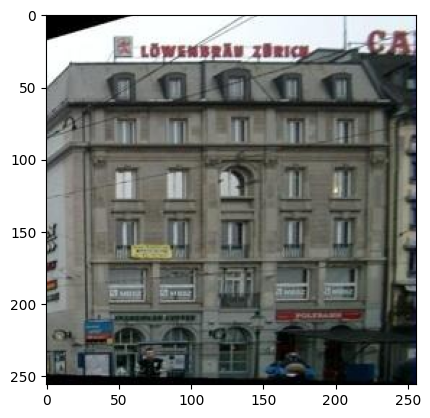

/content/train/dataset/train/images/img00000300_png.rf.4ea273d779bff424cd74e64b4aadc18d.jpg


In [ ]:
example_image_path =  glob.glob(folder_path1+'/*.jpg')[0]
display_image(example_image_path, print_info = True, hide_axis = False)
print(example_image_path)

Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (960, 1280, 3) 



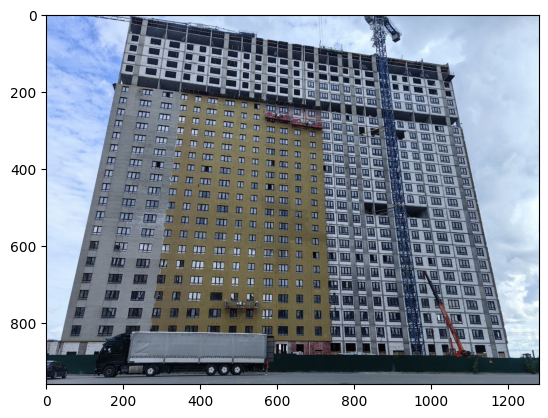

In [ ]:
image_path = '/content/drive/MyDrive/datasets/photo2.jpg'
example_image_path = image_path
display_image(example_image_path, print_info = True, hide_axis = False)

## Visualize many images

In [ ]:
def plot_random_images_from_folder(folder_path, num_images=20, seed=CFG.SEED):

    random.seed(seed)

    # Get a list of image files in the folder
    image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg', '.gif'))]

    # Ensure that we have at least num_images files to choose from
    if len(image_files) < num_images:
        raise ValueError("Not enough images in the folder")

    # Randomly select num_images image files
    selected_files = random.sample(image_files, num_images)

    # Create a subplot grid
    num_cols = 5
    num_rows = (num_images + num_cols - 1) // num_cols
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 8))

    for i, file_name in enumerate(selected_files):
        # Open and display the image using PIL
        img = Image.open(os.path.join(folder_path, file_name))

        if num_rows == 1:
            ax = axes[i % num_cols]
        else:
            ax = axes[i // num_cols, i % num_cols]

        ax.imshow(img)
        ax.axis('off')
        # ax.set_title(file_name)

    # Remove empty subplots
    for i in range(num_images, num_rows * num_cols):
        if num_rows == 1:
            fig.delaxes(axes[i % num_cols])
        else:
            fig.delaxes(axes[i // num_cols, i % num_cols])

    plt.tight_layout()
    plt.show()

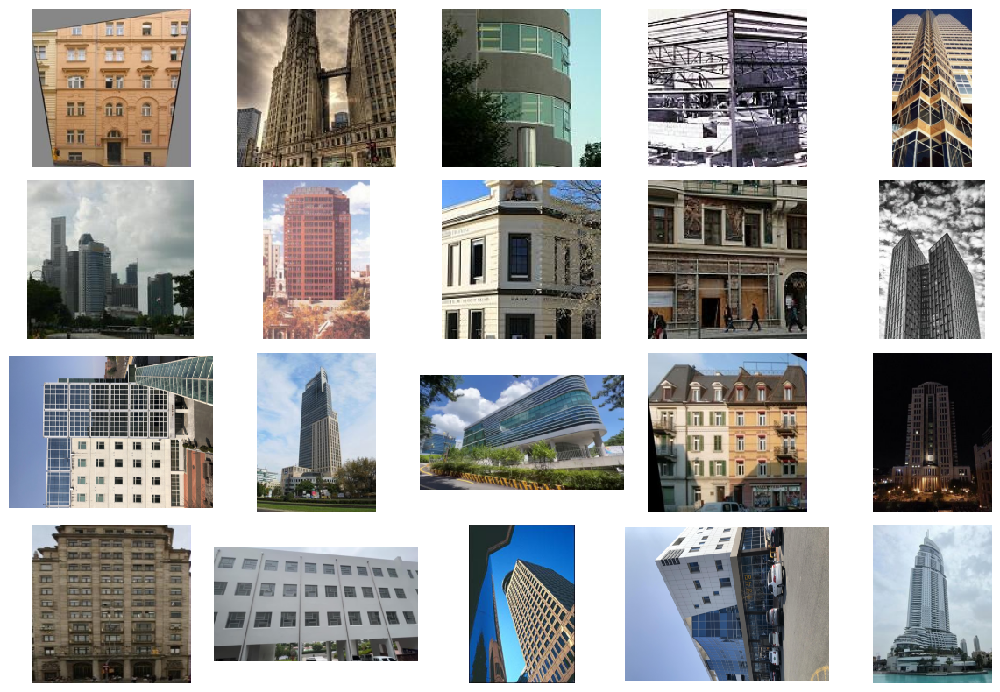

In [ ]:
folder_path = CFG.CUSTOM_DATASET_DIR + 'train/images/'
plot_random_images_from_folder(folder_path, num_images=20, seed=CFG.SEED)
# plot_random_images_from_folder(folder_path, num_images=20, seed=54)

## Image properties

In [ ]:
def get_image_properties(image_path):
    # Read the image file
    img = cv2.imread(image_path)

    # Check if the image file is read successfully
    if img is None:
        raise ValueError("Could not read image file")

    # Get image properties
    properties = {
        "width": img.shape[1],
        "height": img.shape[0],
        "channels": img.shape[2] if len(img.shape) == 3 else 1,
        "dtype": img.dtype,
    }

    return properties

In [ ]:
print(example_image_path)

/content/drive/MyDrive/datasets/photo2.jpg


In [ ]:
img_properties = get_image_properties(example_image_path)
img_properties

{'width': 1280, 'height': 960, 'channels': 3, 'dtype': dtype('uint8')}

## Dataset statistics

In [ ]:
%%time
class_idx = {str(i): CFG.CLASSES[i] for i in range(CFG.NUM_CLASSES_TO_TRAIN)}

class_stat = {}
data_len = {}
class_info = []

for mode in ['train', 'valid', 'test']:
    class_count = {CFG.CLASSES[i]: 0 for i in range(CFG.NUM_CLASSES_TO_TRAIN)}

    path = os.path.join(CFG.CUSTOM_DATASET_DIR, mode, 'labels')

    for file in os.listdir(path):
        with open(os.path.join(path, file)) as f:
            lines = f.readlines()

            for cls in set([line[0] for line in lines]):
                class_count[class_idx[cls]] += 1

    data_len[mode] = len(os.listdir(path))
    class_stat[mode] = class_count

    class_info.append({'Mode': mode, **class_count, 'Data_Volume': data_len[mode]})

dataset_stats_df = pd.DataFrame(class_info)
dataset_stats_df

CPU times: user 65.6 ms, sys: 54.2 ms, total: 120 ms
Wall time: 210 ms


,Mode,Building,Data_Volume
0,train,2081,2082
1,valid,611,611
2,test,300,300


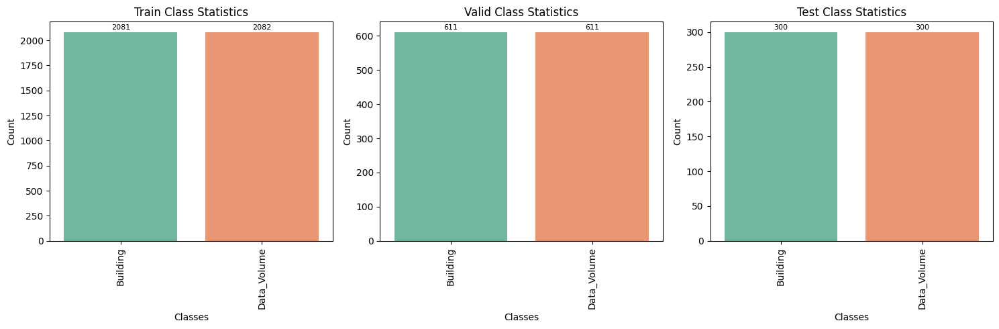

In [ ]:
# Create subplots with 1 row and 3 columns
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot vertical bar plots for each mode in subplots
for i, mode in enumerate(['train', 'valid', 'test']):
    sns.barplot(
        data=dataset_stats_df[dataset_stats_df['Mode'] == mode].drop(columns='Mode'),
        orient='v',
        ax=axes[i],
        palette='Set2'
    )

    axes[i].set_title(f'{mode.capitalize()} Class Statistics')
    axes[i].set_xlabel('Classes')
    axes[i].set_ylabel('Count')
    axes[i].tick_params(axis='x', rotation=90)

    # Add annotations on top of each bar
    for p in axes[i].patches:
        axes[i].annotate(f"{int(p.get_height())}", (p.get_x() + p.get_width() / 2., p.get_height()),
                         ha='center', va='center', fontsize=8, color='black', xytext=(0, 5),
                         textcoords='offset points')

plt.tight_layout()
plt.show()

## Image sizes

In [ ]:
%%time

for mode in ['train', 'valid', 'test']:
    print(f'\nImage sizes in {mode} set:')

    img_size = 0
    for file in glob.glob(os.path.join(CFG.CUSTOM_DATASET_DIR, mode, 'images', '*')):

        image = Image.open(file)

        if image.size != img_size:
            print(f'{image.size}')
            img_size = image.size
            print('\n')

Выходные данные были обрезаны до нескольких последних строк (5000).


(267, 400)


(1280, 720)


(720, 1280)


(150, 150)


(256, 256)


(150, 150)


(223, 400)


(1280, 720)


(256, 256)


(720, 1280)


(1280, 720)


(150, 150)


(720, 1280)


(1280, 720)


(256, 256)


(234, 319)


(213, 319)


(256, 256)


(1280, 720)


(256, 256)


(150, 150)


(256, 256)


(720, 1280)


(150, 150)


(720, 1280)


(256, 256)


(150, 150)


(256, 256)


(1280, 720)


(4032, 3024)


(256, 256)


(1280, 720)


(150, 150)


(256, 256)


(4032, 3024)


(1280, 720)


(256, 256)


(340, 500)


(150, 150)


(1280, 720)


(256, 256)


(150, 150)


(256, 256)


(720, 1280)


(1080, 1920)


(256, 256)


(150, 150)


(1280, 720)


(640, 424)


(500, 335)


(256, 256)


(640, 427)


(266, 400)


(256, 256)


(150, 150)


(256, 256)


(1280, 720)


(256, 500)


(1280, 720)


(150, 150)


(1280, 720)


(150, 150)


(640, 427)


(150, 150)


(180, 240)


(225, 400)


(150, 150)


(256, 256)


(300, 400)


(720, 12

# Base Model Inference

- Just checking the power of the pretrained model inference on the CSS dataset

In [ ]:
CFG.BASE_MODEL_WEIGHTS

'yolov9e.pt'

In [ ]:
import torch
print(torch.version.cuda)

12.6


In [ ]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'  # Указывает на первый GPU

In [ ]:
# Проверка доступности GPU
print(f"GPU доступен: {torch.cuda.is_available()}")
print(f"Количество GPU: {torch.cuda.device_count()}")

GPU доступен: True
Количество GPU: 1


In [ ]:
def detect_random_images_from_folder(folder_path, num_images=20, seed=CFG.SEED, modelPath=example_image_path, classes1 = [0]):

    random.seed(seed)

    # Get a list of image files in the folder
    image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg', '.gif'))]

    # Ensure that we have at least num_images files to choose from
    if len(image_files) < num_images:
        raise ValueError("Not enough images in the folder")

    # Randomly select num_images image files
    selected_files = random.sample(image_files, num_images)

    # Create a subplot grid
    num_cols = 5
    num_rows = (num_images + num_cols - 1) // num_cols
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 8))

    building_model = YOLO(modelPath)

    for i, file_name in enumerate(selected_files):
        # Open and display the image using PIL
        path1 = os.path.join(folder_path, file_name)
        img = Image.open(path1)

        if num_rows == 1:
            ax = axes[i % num_cols]
        else:
            ax = axes[i // num_cols, i % num_cols]

        # ax.imshow(img)
        ax.imshow(img)
        ax.axis('off')
        # ax.set_title(file_name)


        results = building_model.predict(
            source = path1,

            classes = classes1,
            conf = 0.30,
            device = 0, # inference with dual GPU
            imgsz = (img_properties['height'], img_properties['width']),

            save = True,
            save_txt = True,
            save_conf = True,
            exist_ok = True,
        )
        example_image_inference_output = path1.split('/')[-1]
        print(example_image_inference_output)
        img = f'/content/train/runs/detect/predict/{example_image_inference_output}'
        display_image(img)

    # Remove empty subplots
    for i in range(num_images, num_rows * num_cols):
        if num_rows == 1:
            fig.delaxes(axes[i % num_cols])
        else:
            fig.delaxes(axes[i // num_cols, i % num_cols])

    plt.tight_layout()
    plt.show()




In [ ]:
modelWindow = '/content/drive/MyDrive/datasets/windowsYolo9_v4.pt'

In [ ]:
modelBuilding = '/content/drive/MyDrive/datasets/buildingYolo9_v4.pt'


image 1/1 /content/train/dataset/train/images/img00000265_png.rf.93b5607ac10bd25d5e86a5258377590b.jpg: 960x960 10 windowss, 58.3ms
Speed: 15.0ms preprocess, 58.3ms inference, 361.7ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
1 label saved to runs/detect/predict/labels
img00000265_png.rf.93b5607ac10bd25d5e86a5258377590b.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (256, 256, 3) 



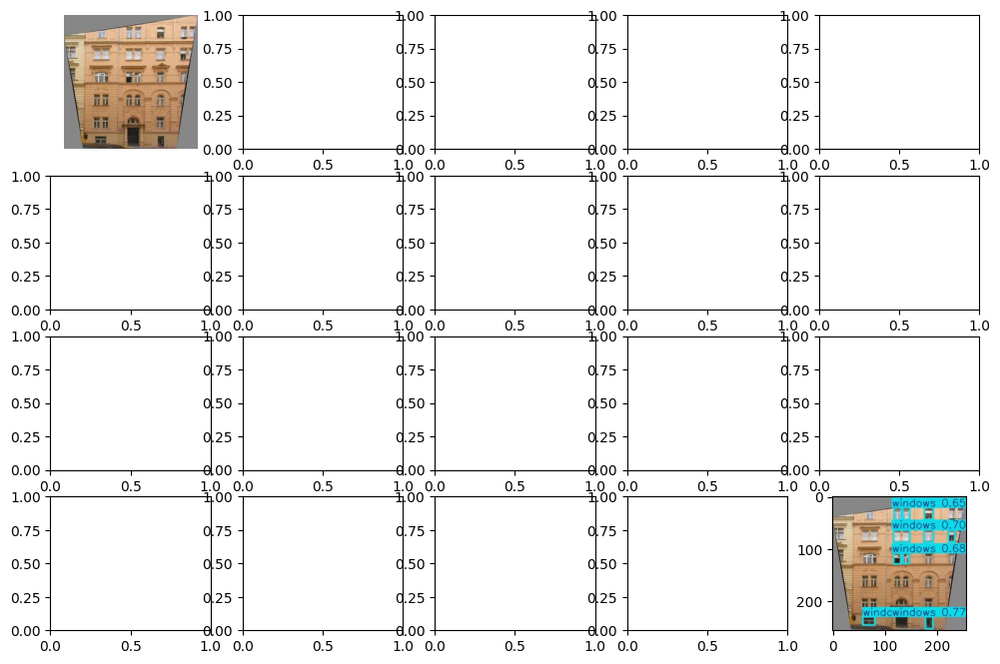


image 1/1 /content/train/dataset/train/images/21159_jpg.rf.b1aba0a24a286e91283a3a71bc01e92f.jpg: 960x960 23 windowss, 35.9ms
Speed: 7.3ms preprocess, 35.9ms inference, 8.6ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
2 labels saved to runs/detect/predict/labels
21159_jpg.rf.b1aba0a24a286e91283a3a71bc01e92f.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (150, 150, 3) 



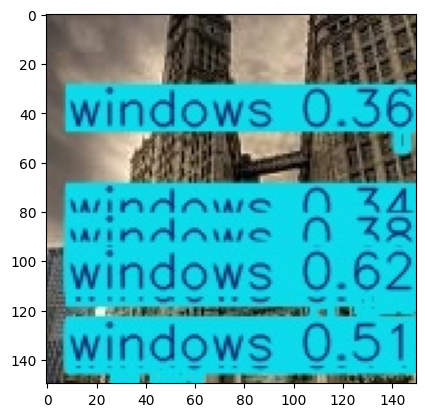


image 1/1 /content/train/dataset/train/images/24063_jpg.rf.8a4b9f2e4abfc318e9dc6756a4645f3a.jpg: 960x960 2 windowss, 36.0ms
Speed: 7.8ms preprocess, 36.0ms inference, 4.1ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
3 labels saved to runs/detect/predict/labels
24063_jpg.rf.8a4b9f2e4abfc318e9dc6756a4645f3a.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (150, 150, 3) 



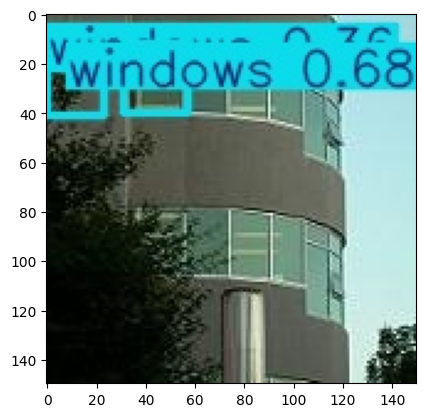


image 1/1 /content/train/dataset/train/images/20218_jpg.rf.a88fc8c225c2b6c76e7e8963439728a1.jpg: 960x960 19 windowss, 35.9ms
Speed: 6.5ms preprocess, 35.9ms inference, 7.0ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
4 labels saved to runs/detect/predict/labels
20218_jpg.rf.a88fc8c225c2b6c76e7e8963439728a1.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (150, 150, 3) 



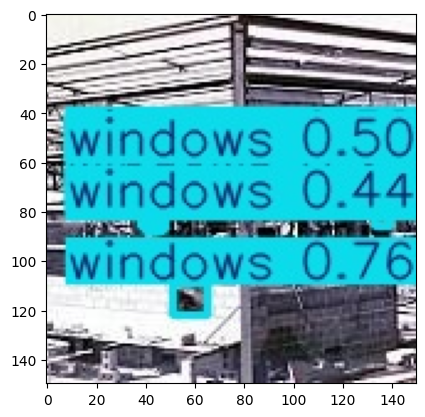


image 1/1 /content/train/dataset/train/images/187_0057_jpg.rf.61a875322cb2388be75f4b11fbd55f9d.jpg: 960x512 2 Windows, 1 windows, 109.5ms
Speed: 5.3ms preprocess, 109.5ms inference, 2.2ms postprocess per image at shape (1, 3, 960, 512)
Results saved to runs/detect/predict
5 labels saved to runs/detect/predict/labels
187_0057_jpg.rf.61a875322cb2388be75f4b11fbd55f9d.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (813, 408, 3) 



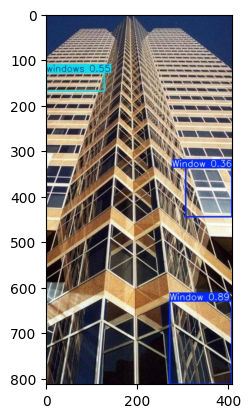


image 1/1 /content/train/dataset/train/images/187_0074_jpg.rf.7557f17a29f8db0fe1cf39fac201c398.jpg: 960x1024 3 windowss, 76.9ms
Speed: 11.6ms preprocess, 76.9ms inference, 2.5ms postprocess per image at shape (1, 3, 960, 1024)
Results saved to runs/detect/predict
6 labels saved to runs/detect/predict/labels
187_0074_jpg.rf.7557f17a29f8db0fe1cf39fac201c398.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (195, 204, 3) 



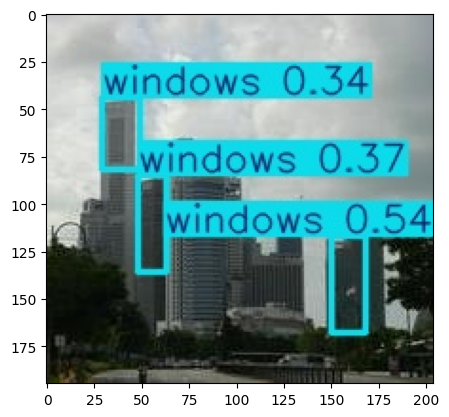


image 1/1 /content/train/dataset/train/images/187_0024_jpg.rf.8b7e2ab4ceb02c3b66fe8d86f4526166.jpg: 960x672 (no detections), 83.7ms
Speed: 5.1ms preprocess, 83.7ms inference, 0.7ms postprocess per image at shape (1, 3, 960, 672)
Results saved to runs/detect/predict
6 labels saved to runs/detect/predict/labels
187_0024_jpg.rf.8b7e2ab4ceb02c3b66fe8d86f4526166.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (373, 250, 3) 



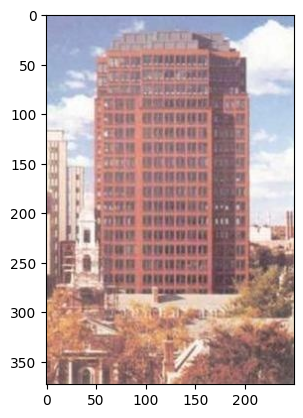


image 1/1 /content/train/dataset/train/images/20723_jpg.rf.2530a7fa8062328db871765d6215b9d2.jpg: 960x960 6 windowss, 36.9ms
Speed: 6.7ms preprocess, 36.9ms inference, 4.8ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
7 labels saved to runs/detect/predict/labels
20723_jpg.rf.2530a7fa8062328db871765d6215b9d2.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (150, 150, 3) 



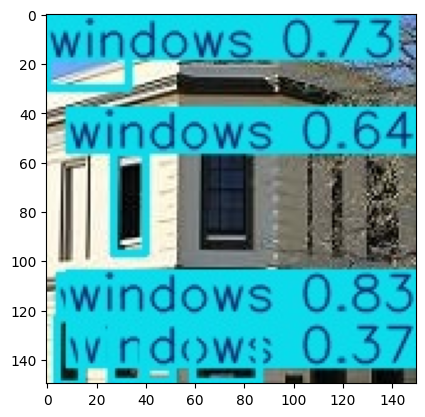


image 1/1 /content/train/dataset/train/images/15699_jpg.rf.a813c5b4ba863ce38064f0f0e358e148.jpg: 960x960 2 windowss, 36.1ms
Speed: 6.3ms preprocess, 36.1ms inference, 2.2ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
8 labels saved to runs/detect/predict/labels
15699_jpg.rf.a813c5b4ba863ce38064f0f0e358e148.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (150, 150, 3) 



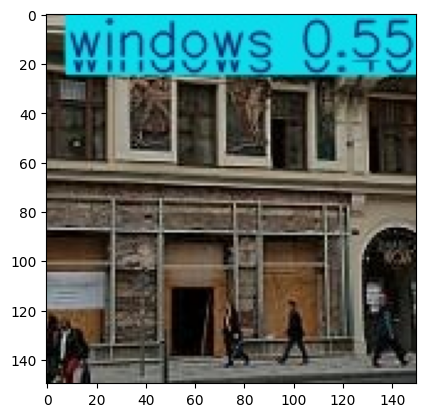


image 1/1 /content/train/dataset/train/images/apartment_33_1_jpg.rf.ecc539850e476dc975f8443c068f2d2d.jpg: 960x672 (no detections), 29.3ms
Speed: 5.4ms preprocess, 29.3ms inference, 0.8ms postprocess per image at shape (1, 3, 960, 672)
Results saved to runs/detect/predict
8 labels saved to runs/detect/predict/labels
apartment_33_1_jpg.rf.ecc539850e476dc975f8443c068f2d2d.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (400, 267, 3) 



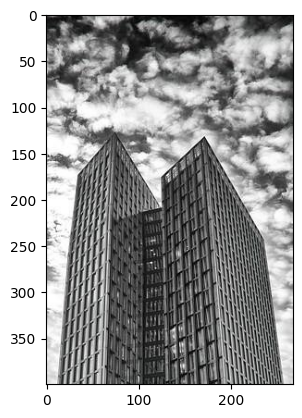


image 1/1 /content/train/dataset/train/images/KakaoTalk_20230322_130245690_25_jpg.rf.83680cead13b681e0955e6735bc538e4.jpg: 960x1280 11 Windows, 54 windowss, 43.9ms
Speed: 9.0ms preprocess, 43.9ms inference, 18.6ms postprocess per image at shape (1, 3, 960, 1280)
Results saved to runs/detect/predict
9 labels saved to runs/detect/predict/labels
KakaoTalk_20230322_130245690_25_jpg.rf.83680cead13b681e0955e6735bc538e4.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (3024, 4032, 3) 



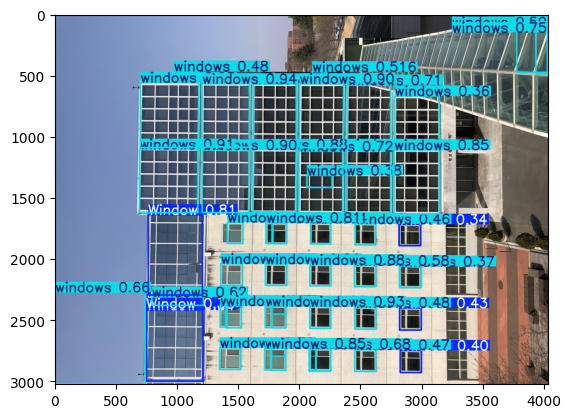


image 1/1 /content/train/dataset/train/images/apartment_1445_jpg.rf.b6b162181ebf2651fec6f4ea1ba59e64.jpg: 960x736 1 windows, 87.4ms
Speed: 5.7ms preprocess, 87.4ms inference, 1.9ms postprocess per image at shape (1, 3, 960, 736)
Results saved to runs/detect/predict
10 labels saved to runs/detect/predict/labels
apartment_1445_jpg.rf.b6b162181ebf2651fec6f4ea1ba59e64.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (320, 240, 3) 



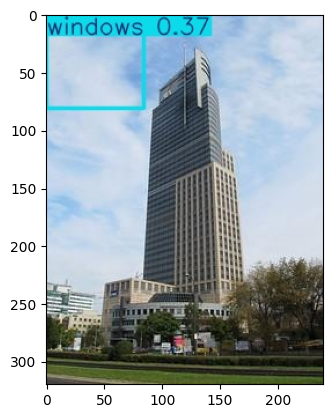


image 1/1 /content/train/dataset/train/images/b704_160_jpg.rf.25e13d034650b09d9194e177f0b26d9d.jpg: 736x1280 (no detections), 88.8ms
Speed: 6.0ms preprocess, 88.8ms inference, 0.8ms postprocess per image at shape (1, 3, 736, 1280)
Results saved to runs/detect/predict
10 labels saved to runs/detect/predict/labels
b704_160_jpg.rf.25e13d034650b09d9194e177f0b26d9d.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (720, 1280, 3) 



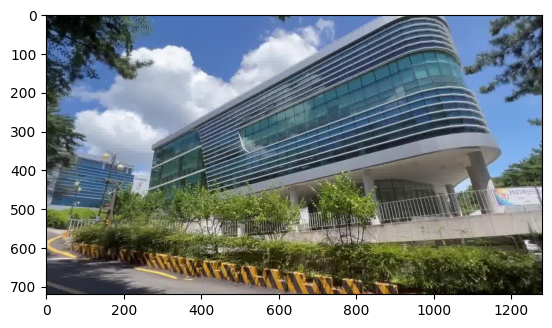


image 1/1 /content/train/dataset/train/images/img00000232_png.rf.4acd035a2d8c9f93a32cc86f7e2852ed.jpg: 960x960 21 windowss, 36.8ms
Speed: 6.3ms preprocess, 36.8ms inference, 10.7ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
11 labels saved to runs/detect/predict/labels
img00000232_png.rf.4acd035a2d8c9f93a32cc86f7e2852ed.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (256, 256, 3) 



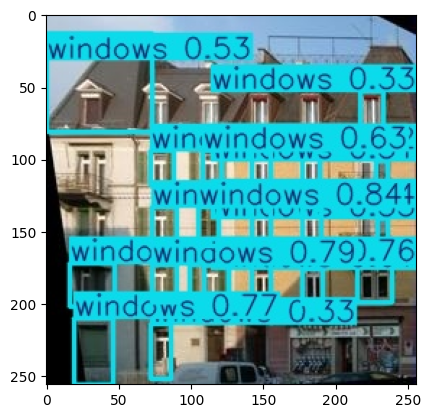


image 1/1 /content/train/dataset/train/images/apartment_1446_jpg.rf.24319dbcadda9f2eb35867b62ff0461c.jpg: 960x736 (no detections), 31.3ms
Speed: 5.4ms preprocess, 31.3ms inference, 0.8ms postprocess per image at shape (1, 3, 960, 736)
Results saved to runs/detect/predict
11 labels saved to runs/detect/predict/labels
apartment_1446_jpg.rf.24319dbcadda9f2eb35867b62ff0461c.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (400, 300, 3) 



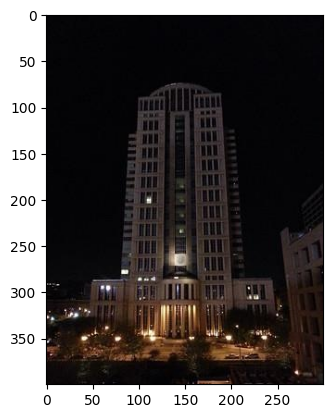


image 1/1 /content/train/dataset/train/images/img00000010_png.rf.54d9bcd311ad1233340c846587ab859a.jpg: 960x960 43 windowss, 36.7ms
Speed: 6.4ms preprocess, 36.7ms inference, 23.6ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
12 labels saved to runs/detect/predict/labels
img00000010_png.rf.54d9bcd311ad1233340c846587ab859a.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (256, 256, 3) 



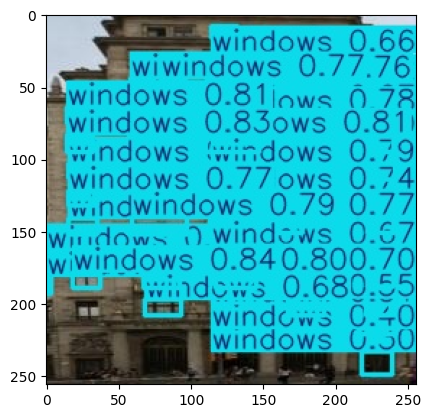


image 1/1 /content/train/dataset/train/images/b306_50_jpg.rf.fd0a64812fef2f2f6292481f714d45dd.jpg: 736x1280 5 Windows, 39 windowss, 36.6ms
Speed: 5.4ms preprocess, 36.6ms inference, 24.7ms postprocess per image at shape (1, 3, 736, 1280)
Results saved to runs/detect/predict
13 labels saved to runs/detect/predict/labels
b306_50_jpg.rf.fd0a64812fef2f2f6292481f714d45dd.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (720, 1280, 3) 



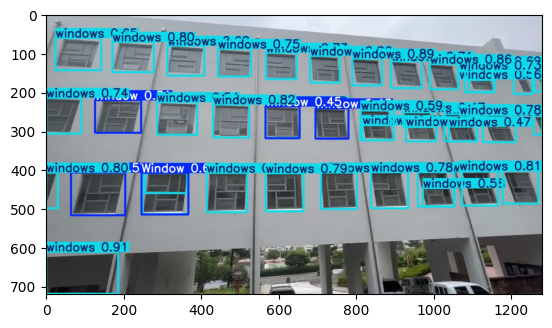


image 1/1 /content/train/dataset/train/images/187_0047_jpg.rf.1dd25ccc7c791551c050ce9bedc1354a.jpg: 960x640 6 windowss, 91.4ms
Speed: 4.6ms preprocess, 91.4ms inference, 11.7ms postprocess per image at shape (1, 3, 960, 640)
Results saved to runs/detect/predict
14 labels saved to runs/detect/predict/labels
187_0047_jpg.rf.1dd25ccc7c791551c050ce9bedc1354a.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (300, 200, 3) 



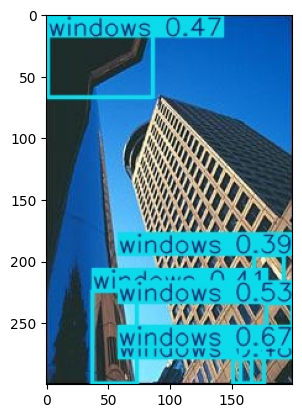


image 1/1 /content/train/dataset/train/images/KakaoTalk_20230322_125719785_04_jpg.rf.35702245b203d29aa0054117f3df0c02.jpg: 960x1280 1 Window, 28 windowss, 44.1ms
Speed: 15.6ms preprocess, 44.1ms inference, 13.4ms postprocess per image at shape (1, 3, 960, 1280)
Results saved to runs/detect/predict
15 labels saved to runs/detect/predict/labels
KakaoTalk_20230322_125719785_04_jpg.rf.35702245b203d29aa0054117f3df0c02.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (3024, 4032, 3) 



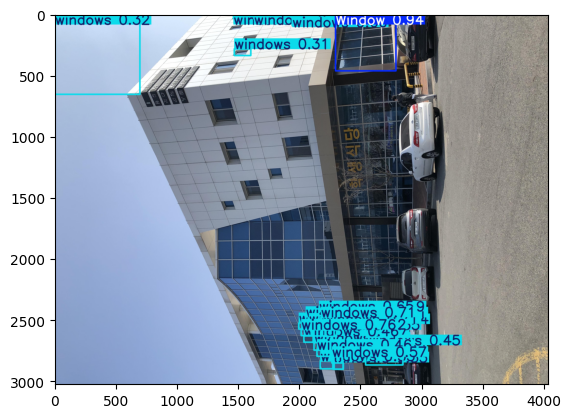


image 1/1 /content/train/dataset/train/images/apartment_00142_jpg.rf.704e4b2e65907804141d9fb6a074d00e.jpg: 960x736 (no detections), 31.4ms
Speed: 6.1ms preprocess, 31.4ms inference, 0.9ms postprocess per image at shape (1, 3, 960, 736)
Results saved to runs/detect/predict
15 labels saved to runs/detect/predict/labels
apartment_00142_jpg.rf.704e4b2e65907804141d9fb6a074d00e.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (320, 240, 3) 



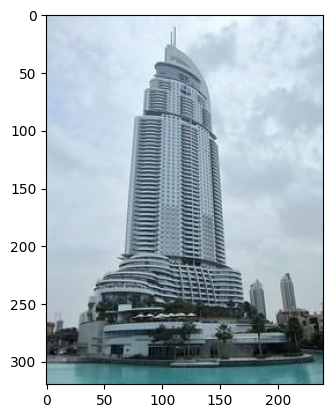

<Figure size 640x480 with 0 Axes>

In [ ]:
folder_path = CFG.CUSTOM_DATASET_DIR + 'train/images/'
detect_random_images_from_folder(folder_path, num_images=20, seed=CFG.SEED, modelPath=modelWindow, classes1 = [0,1])


image 1/1 /content/train/dataset/train/images/img00000265_png.rf.93b5607ac10bd25d5e86a5258377590b.jpg: 960x960 1 Building, 36.3ms
Speed: 4.0ms preprocess, 36.3ms inference, 1.8ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
15 labels saved to runs/detect/predict/labels
img00000265_png.rf.93b5607ac10bd25d5e86a5258377590b.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (256, 256, 3) 



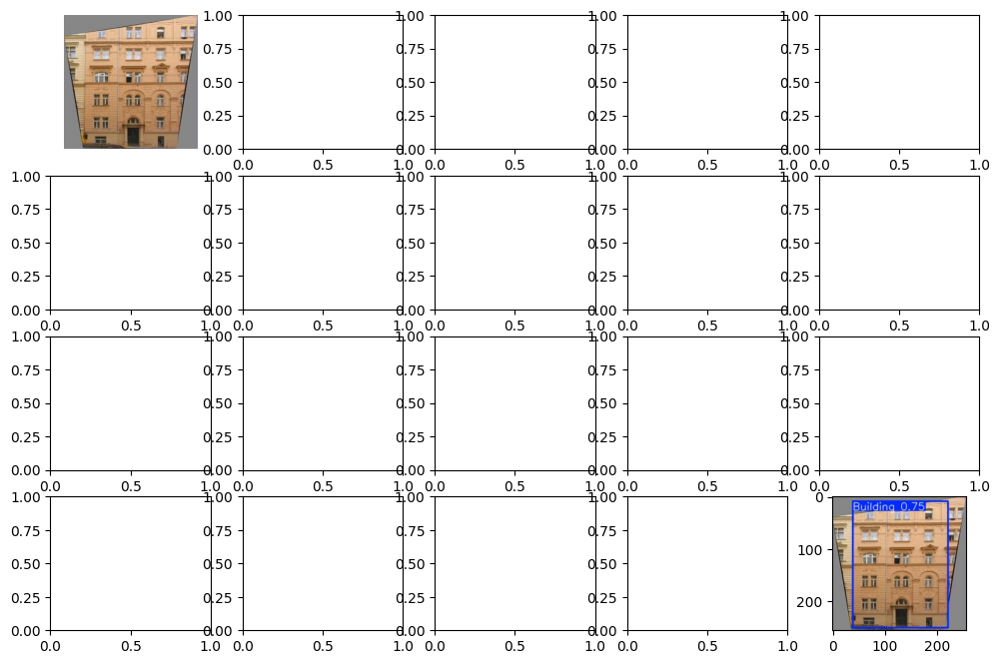


image 1/1 /content/train/dataset/train/images/21159_jpg.rf.b1aba0a24a286e91283a3a71bc01e92f.jpg: 960x960 1 Building, 34.5ms
Speed: 7.1ms preprocess, 34.5ms inference, 2.2ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
15 labels saved to runs/detect/predict/labels
21159_jpg.rf.b1aba0a24a286e91283a3a71bc01e92f.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (150, 150, 3) 



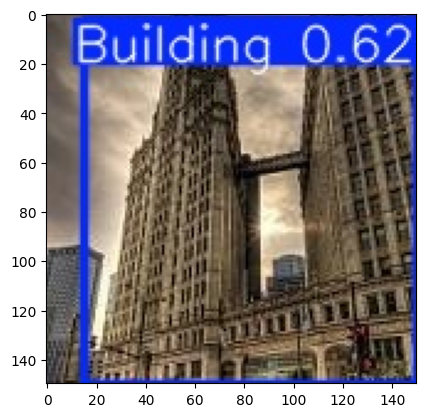


image 1/1 /content/train/dataset/train/images/24063_jpg.rf.8a4b9f2e4abfc318e9dc6756a4645f3a.jpg: 960x960 1 Building, 34.4ms
Speed: 6.5ms preprocess, 34.4ms inference, 2.8ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
15 labels saved to runs/detect/predict/labels
24063_jpg.rf.8a4b9f2e4abfc318e9dc6756a4645f3a.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (150, 150, 3) 



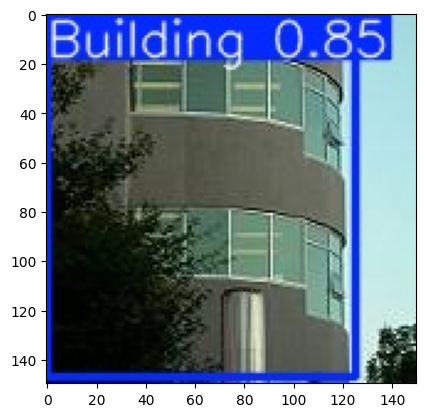


image 1/1 /content/train/dataset/train/images/20218_jpg.rf.a88fc8c225c2b6c76e7e8963439728a1.jpg: 960x960 1 Building, 34.5ms
Speed: 6.0ms preprocess, 34.5ms inference, 2.1ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
15 labels saved to runs/detect/predict/labels
20218_jpg.rf.a88fc8c225c2b6c76e7e8963439728a1.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (150, 150, 3) 



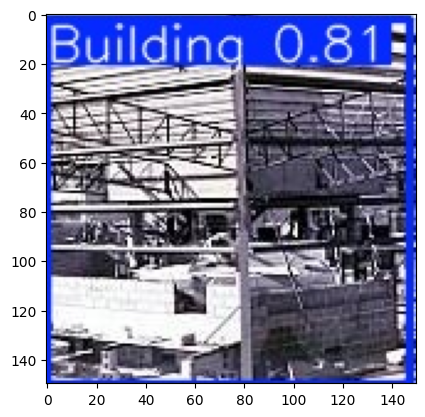


image 1/1 /content/train/dataset/train/images/187_0057_jpg.rf.61a875322cb2388be75f4b11fbd55f9d.jpg: 960x512 1 Building, 26.1ms
Speed: 4.3ms preprocess, 26.1ms inference, 2.7ms postprocess per image at shape (1, 3, 960, 512)
Results saved to runs/detect/predict
15 labels saved to runs/detect/predict/labels
187_0057_jpg.rf.61a875322cb2388be75f4b11fbd55f9d.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (813, 408, 3) 



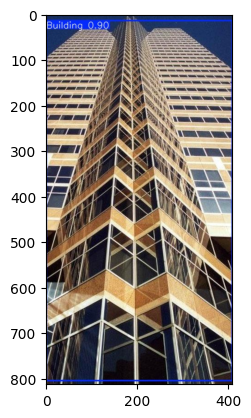


image 1/1 /content/train/dataset/train/images/187_0074_jpg.rf.7557f17a29f8db0fe1cf39fac201c398.jpg: 960x1024 (no detections), 36.4ms
Speed: 8.8ms preprocess, 36.4ms inference, 0.9ms postprocess per image at shape (1, 3, 960, 1024)
Results saved to runs/detect/predict
15 labels saved to runs/detect/predict/labels
187_0074_jpg.rf.7557f17a29f8db0fe1cf39fac201c398.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (195, 204, 3) 



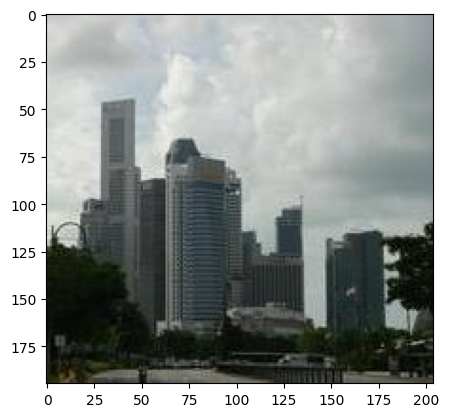


image 1/1 /content/train/dataset/train/images/187_0024_jpg.rf.8b7e2ab4ceb02c3b66fe8d86f4526166.jpg: 960x672 1 Building, 29.2ms
Speed: 4.9ms preprocess, 29.2ms inference, 2.6ms postprocess per image at shape (1, 3, 960, 672)
Results saved to runs/detect/predict
16 labels saved to runs/detect/predict/labels
187_0024_jpg.rf.8b7e2ab4ceb02c3b66fe8d86f4526166.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (373, 250, 3) 



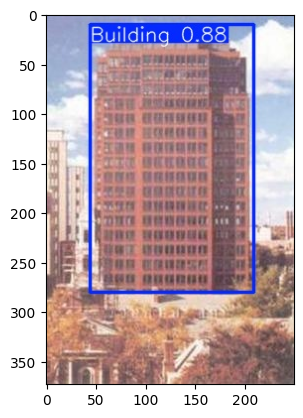


image 1/1 /content/train/dataset/train/images/20723_jpg.rf.2530a7fa8062328db871765d6215b9d2.jpg: 960x960 1 Building, 36.8ms
Speed: 6.1ms preprocess, 36.8ms inference, 2.9ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
16 labels saved to runs/detect/predict/labels
20723_jpg.rf.2530a7fa8062328db871765d6215b9d2.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (150, 150, 3) 



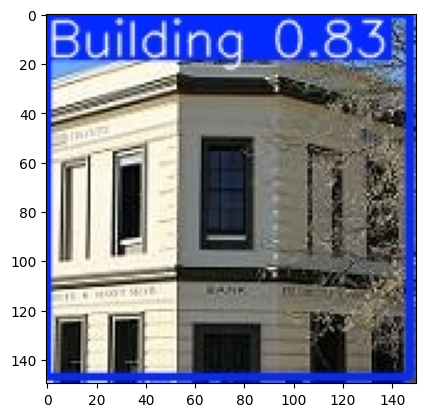


image 1/1 /content/train/dataset/train/images/15699_jpg.rf.a813c5b4ba863ce38064f0f0e358e148.jpg: 960x960 1 Building, 35.9ms
Speed: 7.7ms preprocess, 35.9ms inference, 2.4ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
16 labels saved to runs/detect/predict/labels
15699_jpg.rf.a813c5b4ba863ce38064f0f0e358e148.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (150, 150, 3) 



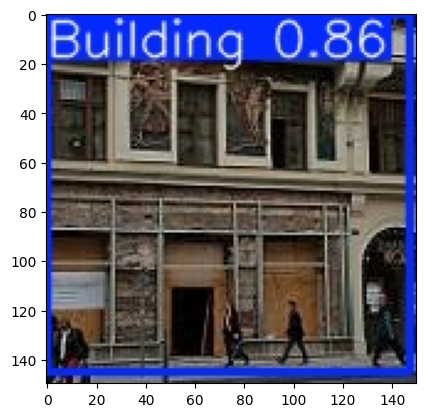


image 1/1 /content/train/dataset/train/images/apartment_33_1_jpg.rf.ecc539850e476dc975f8443c068f2d2d.jpg: 960x672 2 Buildings, 29.2ms
Speed: 6.0ms preprocess, 29.2ms inference, 2.7ms postprocess per image at shape (1, 3, 960, 672)
Results saved to runs/detect/predict
17 labels saved to runs/detect/predict/labels
apartment_33_1_jpg.rf.ecc539850e476dc975f8443c068f2d2d.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (400, 267, 3) 



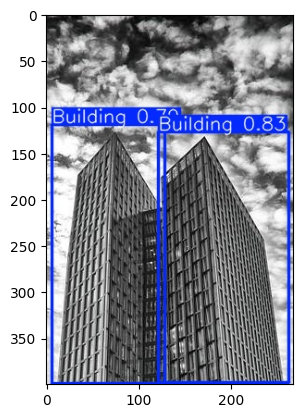


image 1/1 /content/train/dataset/train/images/KakaoTalk_20230322_130245690_25_jpg.rf.83680cead13b681e0955e6735bc538e4.jpg: 960x1280 1 Building, 43.9ms
Speed: 10.0ms preprocess, 43.9ms inference, 1.8ms postprocess per image at shape (1, 3, 960, 1280)
Results saved to runs/detect/predict
17 labels saved to runs/detect/predict/labels
KakaoTalk_20230322_130245690_25_jpg.rf.83680cead13b681e0955e6735bc538e4.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (3024, 4032, 3) 



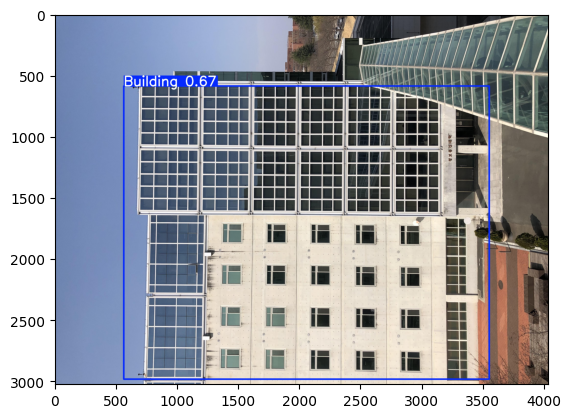


image 1/1 /content/train/dataset/train/images/apartment_1445_jpg.rf.b6b162181ebf2651fec6f4ea1ba59e64.jpg: 960x736 1 Building, 31.2ms
Speed: 6.1ms preprocess, 31.2ms inference, 2.0ms postprocess per image at shape (1, 3, 960, 736)
Results saved to runs/detect/predict
17 labels saved to runs/detect/predict/labels
apartment_1445_jpg.rf.b6b162181ebf2651fec6f4ea1ba59e64.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (320, 240, 3) 



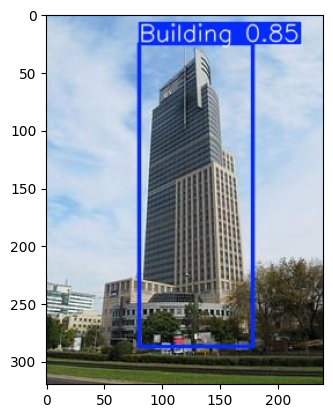


image 1/1 /content/train/dataset/train/images/b704_160_jpg.rf.25e13d034650b09d9194e177f0b26d9d.jpg: 736x1280 1 Building, 36.5ms
Speed: 7.1ms preprocess, 36.5ms inference, 2.2ms postprocess per image at shape (1, 3, 736, 1280)
Results saved to runs/detect/predict
18 labels saved to runs/detect/predict/labels
b704_160_jpg.rf.25e13d034650b09d9194e177f0b26d9d.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (720, 1280, 3) 



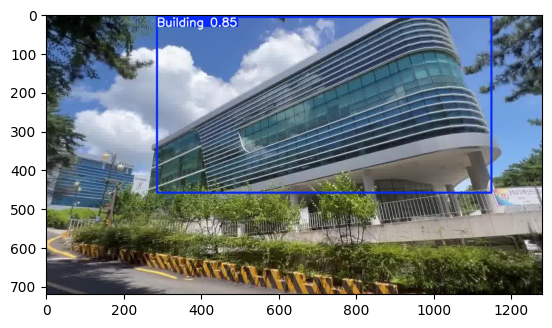


image 1/1 /content/train/dataset/train/images/img00000232_png.rf.4acd035a2d8c9f93a32cc86f7e2852ed.jpg: 960x960 1 Building, 36.8ms
Speed: 7.5ms preprocess, 36.8ms inference, 2.2ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
18 labels saved to runs/detect/predict/labels
img00000232_png.rf.4acd035a2d8c9f93a32cc86f7e2852ed.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (256, 256, 3) 



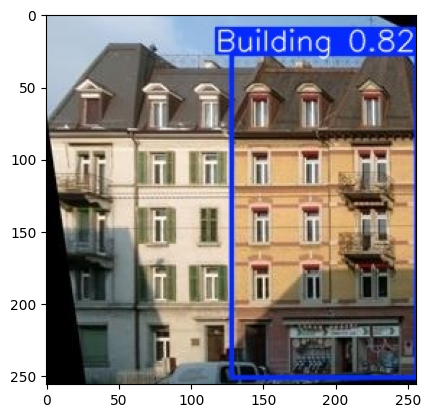


image 1/1 /content/train/dataset/train/images/apartment_1446_jpg.rf.24319dbcadda9f2eb35867b62ff0461c.jpg: 960x736 1 Building, 33.2ms
Speed: 5.4ms preprocess, 33.2ms inference, 2.5ms postprocess per image at shape (1, 3, 960, 736)
Results saved to runs/detect/predict
19 labels saved to runs/detect/predict/labels
apartment_1446_jpg.rf.24319dbcadda9f2eb35867b62ff0461c.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (400, 300, 3) 



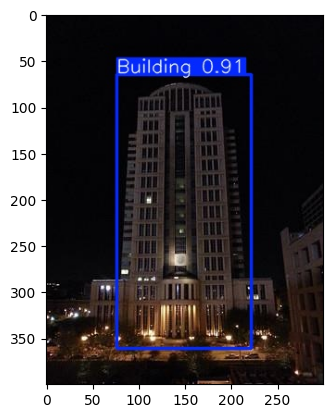


image 1/1 /content/train/dataset/train/images/img00000010_png.rf.54d9bcd311ad1233340c846587ab859a.jpg: 960x960 1 Building, 66.9ms
Speed: 10.3ms preprocess, 66.9ms inference, 13.2ms postprocess per image at shape (1, 3, 960, 960)
Results saved to runs/detect/predict
19 labels saved to runs/detect/predict/labels
img00000010_png.rf.54d9bcd311ad1233340c846587ab859a.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (256, 256, 3) 



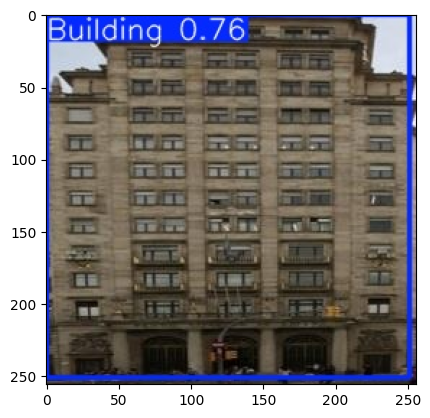


image 1/1 /content/train/dataset/train/images/b306_50_jpg.rf.fd0a64812fef2f2f6292481f714d45dd.jpg: 736x1280 1 Building, 68.4ms
Speed: 11.8ms preprocess, 68.4ms inference, 2.4ms postprocess per image at shape (1, 3, 736, 1280)
Results saved to runs/detect/predict
19 labels saved to runs/detect/predict/labels
b306_50_jpg.rf.fd0a64812fef2f2f6292481f714d45dd.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (720, 1280, 3) 



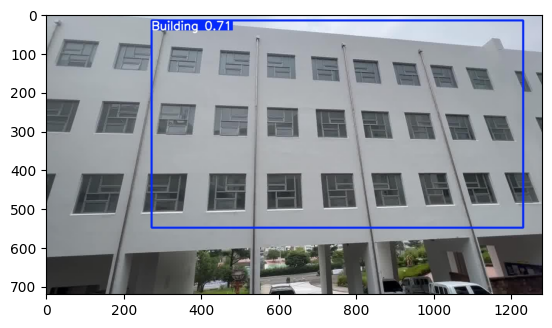


image 1/1 /content/train/dataset/train/images/187_0047_jpg.rf.1dd25ccc7c791551c050ce9bedc1354a.jpg: 960x640 2 Buildings, 28.4ms
Speed: 4.8ms preprocess, 28.4ms inference, 3.0ms postprocess per image at shape (1, 3, 960, 640)
Results saved to runs/detect/predict
19 labels saved to runs/detect/predict/labels
187_0047_jpg.rf.1dd25ccc7c791551c050ce9bedc1354a.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (300, 200, 3) 



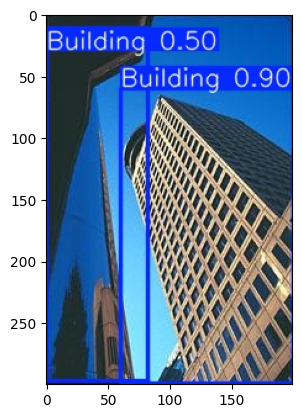


image 1/1 /content/train/dataset/train/images/KakaoTalk_20230322_125719785_04_jpg.rf.35702245b203d29aa0054117f3df0c02.jpg: 960x1280 1 Building, 44.0ms
Speed: 16.2ms preprocess, 44.0ms inference, 1.8ms postprocess per image at shape (1, 3, 960, 1280)
Results saved to runs/detect/predict
19 labels saved to runs/detect/predict/labels
KakaoTalk_20230322_125719785_04_jpg.rf.35702245b203d29aa0054117f3df0c02.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (3024, 4032, 3) 



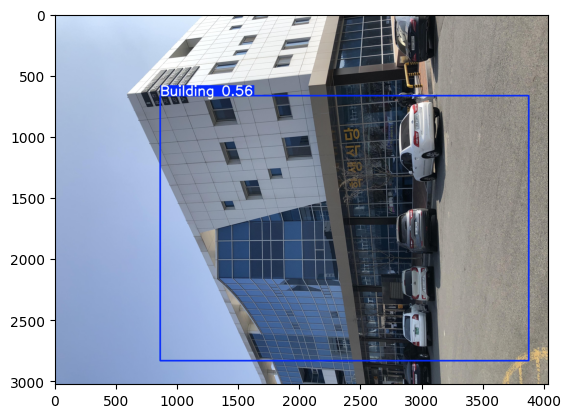


image 1/1 /content/train/dataset/train/images/apartment_00142_jpg.rf.704e4b2e65907804141d9fb6a074d00e.jpg: 960x736 1 Building, 31.3ms
Speed: 7.4ms preprocess, 31.3ms inference, 2.2ms postprocess per image at shape (1, 3, 960, 736)
Results saved to runs/detect/predict
20 labels saved to runs/detect/predict/labels
apartment_00142_jpg.rf.704e4b2e65907804141d9fb6a074d00e.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (320, 240, 3) 



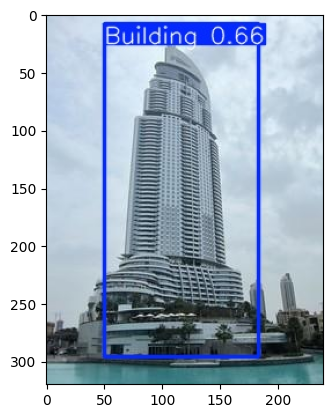

<Figure size 640x480 with 0 Axes>

In [ ]:
folder_path = CFG.CUSTOM_DATASET_DIR + 'train/images/'
detect_random_images_from_folder(folder_path, num_images=20, seed=CFG.SEED, modelPath=modelBuilding)

In [ ]:
# model = YOLO(CFG.BASE_MODEL_WEIGHTS)

In [ ]:
!pwd

/content/train



image 1/1 /content/drive/MyDrive/datasets/photo2.jpg: 960x1280 300 windowss, 43.2ms
Speed: 5.4ms preprocess, 43.2ms inference, 131.5ms postprocess per image at shape (1, 3, 960, 1280)
Results saved to runs/detect/predict
21 labels saved to runs/detect/predict/labels
[ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'Window', 1: 'windows'}
obb: None
orig_img: array([[[243, 182, 150],
        [244, 183, 151],
        [244, 183, 151],
        ...,
        [231, 205, 188],
        [232, 206, 189],
        [233, 207, 190]],

       [[244, 183, 151],
        [244, 183, 151],
        [245, 184, 152],
        ...,
        [232, 206, 189],
        [233, 207, 190],
        [233, 207, 190]],

       [[245, 184, 152],
        [245, 184, 152],
        [245, 184, 152],
        ...,
        [232, 206, 189],
        [233, 207, 190],
        [234, 208, 191]],

       ...,

       [[154, 140, 134],
        

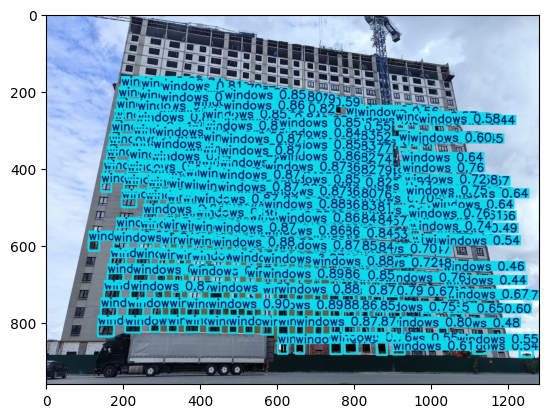

In [ ]:
windows_model = YOLO(modelWindow)
resultsWindows = windows_model.predict(
    source = example_image_path,

    classes = [0,1],
    conf = 0.30,
    device = 0, # inference with dual GPU
    imgsz = (img_properties['height'], img_properties['width']),

    save = True,
    save_txt = True,
    save_conf = True,
    exist_ok = True,
)
example_image_inference_output = example_image_path.split('/')[-1]
print(resultsWindows)
print(example_image_inference_output)
display_image(f'/content/train/runs/detect/predict/{example_image_inference_output}')

In [ ]:
result = resultsWindows[0]

# Получаем bounding boxes
boxes = result.boxes

# Число обнаруженных объектов (окон)
num_windows = len(boxes)

# Опционально: можно посмотреть классы
class_ids = boxes.cls.cpu().numpy()  # классы (0 или 1)
class_names = result.names  # {0: 'Window', 1: 'windows'}

# Подсчёт по классам (если нужно)
from collections import Counter
class_counts = Counter(class_ids)
class_counts_named = {class_names[int(cls_id)]: count for cls_id, count in class_counts.items()}

print(f"Всего обнаружено окон: {num_windows}")
for name, count in class_counts_named.items():
    print(f"  - {name}: {count}")

Всего обнаружено окон: 300
  - windows: 300



image 1/1 /content/drive/MyDrive/datasets/photo2.jpg: 960x1280 1 Building, 38.7ms
Speed: 5.5ms preprocess, 38.7ms inference, 2.3ms postprocess per image at shape (1, 3, 960, 1280)
Results saved to runs/detect/predict
21 labels saved to runs/detect/predict/labels
photo2.jpg
Type:  <class 'PIL.JpegImagePlugin.JpegImageFile'> 

Shape:  (960, 1280, 3) 



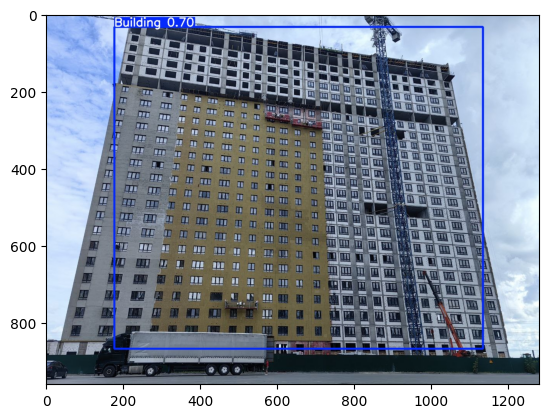

In [ ]:
building_model = YOLO(modelBuilding)
resultsBuilding = building_model.predict(
    source = example_image_path,

    classes = [0],
    conf = 0.30,
    device = 0, # inference with dual GPU
    imgsz = (img_properties['height'], img_properties['width']),

    save = True,
    save_txt = True,
    save_conf = True,
    exist_ok = True,
)
example_image_inference_output = example_image_path.split('/')[-1]
print(example_image_inference_output)
display_image(f'/content/train/runs/detect/predict/{example_image_inference_output}')

# Export

- [Export mode](https://docs.ultralytics.com/modes/export/) is used for exporting a YOLOv9 model to a format that can be used for deployment. In this mode, the model is converted to a format that can be used by other software applications or hardware devices. This mode is useful when deploying the model to production environments.

In [ ]:
img_properties

{'width': 1280, 'height': 960, 'channels': 3, 'dtype': dtype('uint8')}

In [ ]:
# # Export the model
# building_model.export(
#     format = 'onnx', # openvino, onnx, engine, tflite
#     imgsz = (img_properties['height'], img_properties['width']),
#     half = False,
#     int8 = False,
#     simplify = False,
#     nms = False,
# )# Export the model
# windows_model.export(
#     format = 'onnx', # openvino, onnx, engine, tflite
#     imgsz = (img_properties['height'], img_properties['width']),
#     half = False,
#     int8 = False,
#     simplify = False,
#     nms = False,
# )

In [ ]:
# Загрузка изображения

img = cv2.imread(image_path)

# Детектирование зданий
results_building = building_model(img)
for result in results_building:
    boxes = result.boxes.cpu().numpy()
    for box in boxes:
        x1, y1, x2, y2 = box.xyxy[0]
        print(f"Building detected at: ({x1}, {y1}) - ({x2}, {y2})")

# Детектирование окон
results_windows = windows_model(img)
for result in results_windows:
    boxes = result.boxes.cpu().numpy()
    for box in boxes:
        x1, y1, x2, y2 = box.xyxy[0]
        print(f"Window detected at: ({x1}, {y1}) - ({x2}, {y2})")


0: 960x1280 1 Building, 43.5ms
Speed: 5.9ms preprocess, 43.5ms inference, 2.9ms postprocess per image at shape (1, 3, 960, 1280)
Results saved to runs/detect/predict
22 labels saved to runs/detect/predict/labels
Building detected at: (177.128662109375, 33.88751220703125) - (1134.735595703125, 868.5811767578125)

0: 192x224 29 windowss, 118.4ms
Speed: 0.8ms preprocess, 118.4ms inference, 11.2ms postprocess per image at shape (1, 3, 192, 224)
Results saved to runs/detect/predict
22 labels saved to runs/detect/predict/labels
Window detected at: (594.318603515625, 104.83121490478516) - (674.8549194335938, 163.36598205566406)
Window detected at: (346.5517272949219, 78.8845443725586) - (420.5953063964844, 141.55618286132812)
Window detected at: (512.4461059570312, 102.0058822631836) - (594.6067504882812, 172.5115203857422)
Window detected at: (672.8617553710938, 112.81017303466797) - (772.0697021484375, 167.5840301513672)
Window detected at: (434.0509033203125, 98.63590240478516) - (511.846

In [ ]:
# Визуализация результатов для зданий
building_results = building_model.predict(source=image_path, save=True, project='output', name='buildings')

# Визуализация результатов для окон
windows_results = windows_model.predict(source=image_path, save=True, project='output', name='windows')


image 1/1 /content/drive/MyDrive/datasets/photo2.jpg: 960x1280 1 Building, 43.3ms
Speed: 8.9ms preprocess, 43.3ms inference, 2.3ms postprocess per image at shape (1, 3, 960, 1280)
Results saved to output/buildings
1 label saved to output/buildings/labels

image 1/1 /content/drive/MyDrive/datasets/photo2.jpg: 192x224 29 windowss, 19.9ms
Speed: 0.9ms preprocess, 19.9ms inference, 11.0ms postprocess per image at shape (1, 3, 192, 224)
Results saved to output/windows
1 label saved to output/windows/labels


# Train results

In [ ]:
results_paths = [
    i for i in
    glob.glob(f'{CFG.OUTPUT_DIR}runs/detect/{CFG.BASE_MODEL}_{CFG.EXP_NAME}/*.png') +
    glob.glob(f'{CFG.OUTPUT_DIR}runs/detect/{CFG.BASE_MODEL}_{CFG.EXP_NAME}/*.jpg')
    if 'batch' not in i
]

results_paths

[]

In [ ]:
for file in sorted(results_paths):
    print(file)
    display_image(file, print_info = False, hide_axis = True)
    print('\n')

# Validation results

In [ ]:
validation_results_paths = [
    i for i in
    glob.glob(f'{CFG.OUTPUT_DIR}runs/detect/{CFG.BASE_MODEL}_{CFG.EXP_NAME}/*.png') +
    glob.glob(f'{CFG.OUTPUT_DIR}runs/detect/{CFG.BASE_MODEL}_{CFG.EXP_NAME}/*.jpg')
    if 'val_batch' in i
]

len(validation_results_paths)

0

In [ ]:
if len(validation_results_paths) >= 1:
    print(validation_results_paths[-1])

In [ ]:
### check predictions or labels from a random validation batch
if len(validation_results_paths) >= 1:
    val_img_path = random.choice(validation_results_paths)
    print(val_img_path)
    display_image(val_img_path, print_info = False, hide_axis = True)

Анализ слоев в порядке следования:
1. Не финишная штукатурка :
   Процент слоя: 22.69%
   Совокупный процент: 22.69%

2. утеплитель :
   Процент слоя: 18.59%
   Совокупный процент: 41.28%

3. кладка :
   Процент слоя: 9.73%
   Совокупный процент: 51.00%



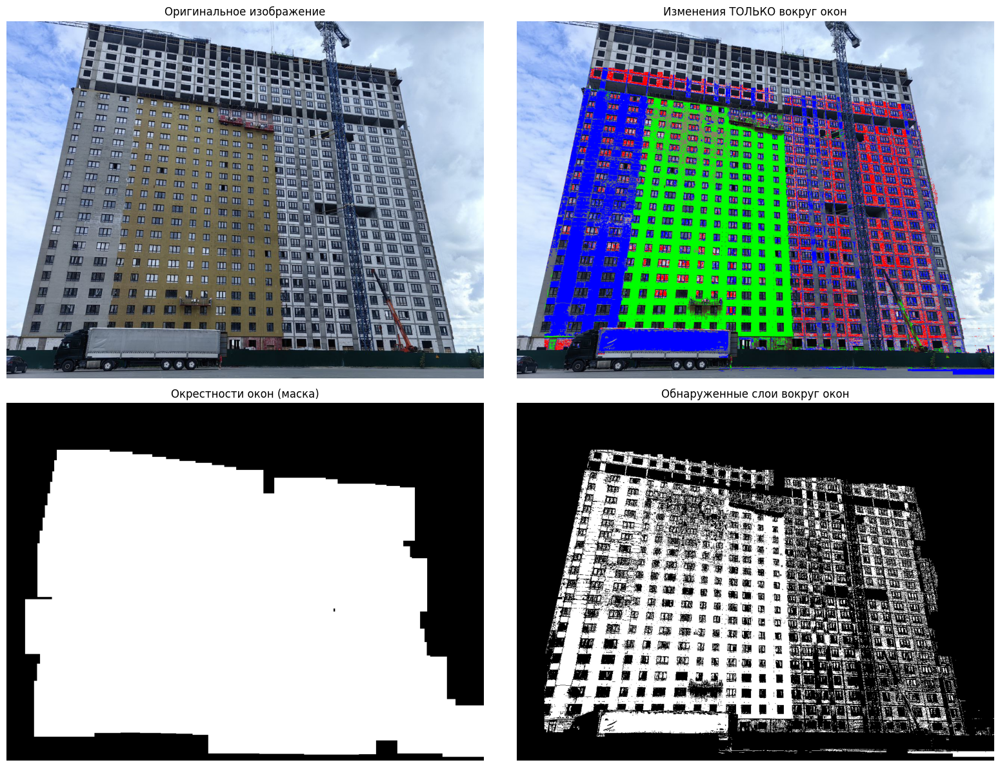

Результат визуализации сохранён: only_around_windows.jpg
Найдено 300 окон. Анализирую окрестности...

Всего обнаружено окон: 300
  - windows: 300

ОБОБЩЁННЫЕ РЕЗУЛЬТАТЫ ПО ОКРЕСТНОСТЯМ ОКОН
Не финишная штукатурка:
  Средний процент: 25.01%
  Стандартное отклонение: 23.69%
  Общее число пикселей: 1116861
  Проанализировано окон: 300

утеплитель:
  Средний процент: 47.82%
  Стандартное отклонение: 39.21%
  Общее число пикселей: 2051371
  Проанализировано окон: 300

кладка:
  Средний процент: 9.30%
  Стандартное отклонение: 9.43%
  Общее число пикселей: 408827
  Проанализировано окон: 300



In [ ]:
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

def hex_to_rgb(hex_color):
    """Конвертирует hex цвет в RGB"""
    hex_color = hex_color.lstrip('#')
    return tuple(int(hex_color[i:i+2], 16) for i in (0, 2, 4))

def rgb_to_hex(rgb_color):
    """Конвертирует RGB цвет в hex"""
    return '#{:02x}{:02x}{:02x}'.format(rgb_color[0], rgb_color[1], rgb_color[2])

def analyze_image_layers(image_path, color_configs, showHint = True):
    """
    Анализирует изображение с учетом последовательности слоев

    Args:
        image_path (str): Путь к изображению
        color_configs (list): Список конфигураций цветов с заменами

    Returns:
        dict: Результаты анализа
    """

    # Загружаем изображение
    image = cv2.imread(image_path)
    if image is None:
        raise FileNotFoundError(f"Не удалось загрузить изображение: {image_path}")

    # Конвертируем BGR в RGB для правильного отображения
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Преобразуем изображение в массив пикселей
    pixels = image_rgb.reshape((-1, 3))

    # Создаем копию для результата
    result_image = image_rgb.copy()
    result_pixels = result_image.reshape((-1, 3))

    # Создаем маску для общего результата
    overall_mask = np.zeros(len(pixels), dtype=bool)

    # Словарь для хранения результатов по каждому слою
    layer_results = {}

    if showHint:
      print("Анализ слоев в порядке следования:")
      print("=" * 60)

    # Анализируем каждый цвет в порядке следования
    cumulative_mask = np.zeros(len(pixels), dtype=bool)  # Накопительная маска

    for i, config in enumerate(color_configs):
        target_color_hex = config['color']
        target_color_rgb = hex_to_rgb(target_color_hex)
        tolerance = config['tolerance']
        name = config.get('name', f'Слой {i+1}')
        replacement_color_hex = config.get('replacement_color', '#000000')
        replacement_color_rgb = hex_to_rgb(replacement_color_hex)

        # Вычисляем евклидово расстояние до целевого цвета
        distances = np.sqrt(np.sum((pixels - target_color_rgb) ** 2, axis=1))

        # Создаем маску для текущего цвета
        current_mask = distances <= tolerance

        # Создаем маску с учетом уже обработанных слоев (накопительная маска)
        layer_mask = current_mask & ~cumulative_mask

        # Обновляем накопительную маску
        cumulative_mask = cumulative_mask | current_mask

        # Подсчитываем статистику
        current_count = np.sum(current_mask)  # Все пиксели текущего цвета
        layer_count = np.sum(layer_mask)      # Только уникальные пиксели слоя
        total_pixels = len(pixels)*7/10

        layer_percentage = ((layer_count / total_pixels) * 100)
        cumulative_percentage = (np.sum(cumulative_mask) / total_pixels) * 100

        # Сохраняем результаты
        layer_results[name] = {
            'mask': layer_mask,
            'count': layer_count,
            'percentage': layer_percentage,
            'cumulative_percentage': cumulative_percentage,
            'color': target_color_rgb,
            'replacement_color': replacement_color_rgb,
            'tolerance': tolerance
        }

        # Заменяем пиксели текущего слоя на указанный цвет
        result_pixels[layer_mask] = replacement_color_rgb

        if showHint:
          print(f"{i+1}. {name} :")
          # ({target_color_hex})
          # print(f"   Цвет замены: {replacement_color_hex}")
          # print(f"   Диапазон (tolerance): {tolerance}")
          # print(f"   Уникальные пиксели слоя: {layer_count}")
          print(f"   Процент слоя: {layer_percentage:.2f}%")
          print(f"   Совокупный процент: {cumulative_percentage:.2f}%")
          print()

    # Формируем финальное изображение
    result_image = result_pixels.reshape(image_rgb.shape)

    # Создаем маску для каждого слоя отдельно
    layer_masks_images = {}
    for name, data in layer_results.items():
        mask_image = np.zeros_like(image_rgb)
        mask_pixels = data['mask'].reshape(image_rgb.shape[:2])
        mask_image[mask_pixels] = [255, 255, 255]
        layer_masks_images[name] = mask_image

    # Создаем общую маску
    overall_mask_image = np.zeros_like(image_rgb)
    overall_mask_pixels = cumulative_mask.reshape(image_rgb.shape[:2])
    overall_mask_image[overall_mask_pixels] = [255, 255, 255]

    return {
        'layer_results': layer_results,
        'result_image': result_image,
        'layer_masks': layer_masks_images,
        'overall_mask': overall_mask_image,
        'total_pixels': len(pixels),
        'cumulative_mask': cumulative_mask
    }

def save_layer_results(results, original_path, output_prefix="result"):
    """
    Сохраняет результаты анализа для каждого слоя
    """

    # Сохраняем финальное изображение с заменами
    result_pil = Image.fromarray(results['result_image'])
    result_path = f"{output_prefix}_final_result.jpg"
    result_pil.save(result_path)
    print(f"Финальное изображение сохранено: {result_path}")

    # Сохраняем маску для каждого слоя
    for name, mask_image in results['layer_masks'].items():
        # Очищаем имя от специальных символов для имени файла
        clean_name = "".join(c for c in name if c.isalnum() or c in (' ', '-', '_')).rstrip()
        mask_pil = Image.fromarray(mask_image)
        mask_path = f"{output_prefix}_mask_{clean_name}.jpg"
        mask_pil.save(mask_path)
        print(f"Маска слоя '{name}' сохранена: {mask_path}")

    # Сохраняем общую маску
    overall_mask_pil = Image.fromarray(results['overall_mask'])
    overall_mask_path = f"{output_prefix}_overall_mask.jpg"
    overall_mask_pil.save(overall_mask_path)
    print(f"Общая маска сохранена: {overall_mask_path}")

    # Сохраняем оригинальное изображение для сравнения
    original = cv2.imread(original_path)
    original_rgb = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
    original_pil = Image.fromarray(original_rgb)
    original_pil.save(f"{output_prefix}_original.jpg")

def visualize_layer_results_around_windows(image_path, results, window_areas, output_path=None):
    """
    Визуализирует результаты анализа слоев ТОЛЬКО вокруг окон.

    Args:
        image_path (str): Путь к оригинальному изображению
        results (dict): Результаты analyze_image_layers (всё изображение)
        window_areas (list): Список областей вокруг окон с координатами (как из extract_window_areas)
        output_path (str): Опционально — путь для сохранения результата
    """
    # Загружаем оригинальное изображение
    original = cv2.imread(image_path)
    original_rgb = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
    h, w = original_rgb.shape[:2]

    # Копируем оригинальное изображение для наложения изменений
    modified_image = original_rgb.copy()

    # Получаем маску изменённых пикселей (например, все пиксели, где был обнаружен слой)
    # Можно использовать overall_mask или result_image != original
    # Но у нас уже есть cumulative_mask в results — он показывает, какие пиксели были изменены
    cumulative_mask_full = results['cumulative_mask'].reshape(h, w)  # (H, W) boolean

    # Создаём маску: True только в окрестностях окон
    window_mask = np.zeros((h, w), dtype=bool)
    for area in window_areas:
        x1, y1, x2, y2 = area['padded_coords']
        window_mask[y1:y2, x1:x2] = True

    # Комбинируем: изменения учитываются ТОЛЬКО в окрестностях окон
    final_change_mask = cumulative_mask_full & window_mask

    # Накладываем изменённые пиксели только в этих зонах
    result_img = results['result_image']
    modified_image[final_change_mask] = result_img[final_change_mask]

    # Визуализация
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    axes = axes.flatten()

    # 1. Оригинал
    axes[0].imshow(original_rgb)
    axes[0].set_title('Оригинальное изображение')
    axes[0].axis('off')

    # 2. Только изменения вокруг окон
    axes[1].imshow(modified_image)
    axes[1].set_title('Изменения ТОЛЬКО вокруг окон')
    axes[1].axis('off')

    # 3. Маска окрестностей окон
    window_mask_vis = np.zeros_like(original_rgb)
    window_mask_vis[window_mask] = [255, 255, 255]
    axes[2].imshow(window_mask_vis)
    axes[2].set_title('Окрестности окон (маска)')
    axes[2].axis('off')

    # 4. Маска фактически изменённых пикселей (в зоне окон)
    change_mask_vis = np.zeros_like(original_rgb)
    change_mask_vis[final_change_mask] = [255, 255, 255]
    axes[3].imshow(change_mask_vis)
    axes[3].set_title('Обнаруженные слои вокруг окон')
    axes[3].axis('off')

    plt.tight_layout()
    plt.show()

    # Сохранение (опционально)
    if output_path:
        Image.fromarray(modified_image).save(output_path)
        print(f"Результат визуализации сохранён: {output_path}")

    return modified_image


# Основной код
if 0:
    # Путь к изображению
    image_path = "/content/drive/MyDrive/datasets/photo2.jpg"

    # НАСТРОЙКИ ЦВЕТОВ С ИНДИВИДУАЛЬНЫМИ ДИАПАЗОНАМИ И ЦВЕТАМИ ЗАМЕНЫ
    color_configs = [
         {
            'color': '#7c828e',              # Цвет не финишной штукатурки
            'tolerance': 40,                 # РАСШИРЕННЫЙ диапазон
            'name': 'Не финишная штукатурка', # Название для отчета
            'replacement_color': '#0000FF'   # Цвет замены - синий
        },
        {
            'color': '#6d6444',              # Цвет утеплителя
            'tolerance': 40,                 # УМЕНЬШЕННЫЙ диапазон
            'name': 'утеплитель',            # Название для отчета
            'replacement_color': '#00FF00'   # Цвет замены - зеленый
        },{
            'color': '#aab6c7',              # Цвет кладки
            'tolerance': 50,                 # УМЕНЬШЕННЫЙ диапазон
            'name': 'кладка',                # Название для отчета
            'replacement_color': '#FF0000'   # Цвет замены - красный
        }

    ]

    try:
        # Анализируем изображение
        print("Анализ изображения с учетом последовательности слоев...")
        results = analyze_image_layers(image_path, color_configs)

        # Визуализируем результаты
        print("\nВизуализация результатов...")
        # visualize_layer_results(image_path, results)

        # Сохраняем результаты
        print("\nСохранение результатов...")
        save_layer_results(results, image_path, "photo2_analysis")

        print(f"\nАнализ завершен!")
        print("Подробная статистика выше ↑")

    except Exception as e:
        print(f"Ошибка: {e}")



def extract_window_areas(image_path, results, padding=50):
    """
    Извлекает области вокруг окон с отступом (padding)

    Args:
        image_path (str): Путь к изображению
        results (ultralytics.Results): Результаты YOLO
        padding (int): Отступ от границ окна (в пикселях)

    Returns:
        list of dict: Список словарей с обрезанным изображением и координатами
    """
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Получаем bounding boxes
    boxes = results[0].boxes.xyxy.cpu().numpy()  # [x1, y1, x2, y2]
    orig_h, orig_w = results[0].orig_shape

    window_areas = []

    for i, box in enumerate(boxes):
        x1, y1, x2, y2 = map(int, box)

        # Расширяем bounding box с padding
        x1_pad = max(0, x1 - padding)
        y1_pad = max(0, y1 - padding)
        x2_pad = min(orig_w, x2 + padding)
        y2_pad = min(orig_h, y2 + padding)

        # Обрезаем изображение
        cropped = image_rgb[y1_pad:y2_pad, x1_pad:x2_pad]

        window_areas.append({
            'cropped_image': cropped,
            'original_coords': (x1, y1, x2, y2),
            'padded_coords': (x1_pad, y1_pad, x2_pad, y2_pad),
            'index': i
        })

    return window_areas


def analyze_around_windows(image_path, yolo_results, color_configs, padding=50, output_prefix="window_area"):
    """
    Анализирует слои только вокруг окон

    Args:
        image_path (str): Путь к изображению
        yolo_results (ultralytics.Results): Результаты YOLO
        color_configs (list): Конфигурация цветов
        padding (int): Отступ от окна
        output_prefix (str): Префикс для сохранения

    Returns:
        dict: Обобщённые результаты по всем окнам
    """
    # Извлекаем области вокруг окон
    window_areas = extract_window_areas(image_path, yolo_results, padding)



    # После вызова analyze_around_windows или вручную:
    # window_areas = extract_window_areas(image_path, results, padding=60)

    # Полный анализ всего изображения (нужен result_image и cumulative_mask)
    full_results = analyze_image_layers(image_path, color_configs)

    # Визуализация с фокусом на окнах
    visualize_layer_results_around_windows(
        image_path=image_path,
        results=full_results,
        window_areas=window_areas,
        output_path="only_around_windows.jpg"
    )




    all_layer_stats = {cfg['name']: [] for cfg in color_configs}
    all_analysis_results = []

    print(f"Найдено {len(window_areas)} окон. Анализирую окрестности...\n")
    print("=" * 70)

    for area in window_areas:
        idx = area['index']
        cropped_img = area['cropped_image']

        # Сохраняем временное изображение для analyze_image_layers
        temp_path = f"/tmp/window_area_{idx}.jpg"
        Image.fromarray(cropped_img).save(temp_path)

        # Анализируем эту область
        try:
            results = analyze_image_layers(temp_path, color_configs, False)

            # Собираем статистику по слоям
            for name, data in results['layer_results'].items():
                all_layer_stats[name].append({
                    'percentage': data['percentage'],
                    'count': data['count']
                })

            # Сохраняем результаты по каждому окну
            # area_output = f"{output_prefix}_area_{idx}"
            # save_layer_results(results, temp_path, area_output)
            # all_analysis_results.append({
            #     'index': idx,
            #     'results': results,
            #     'image': cropped_img
            # })





            # Визуализируем результаты
            # print("\n!!!!!!!!!!!!!Визуализация результатов...")
            # visualize_layer_results(temp_path, results)




            # print(f"Окно {idx}: анализ завершён.")
        except Exception as e:
            print(f"Ошибка при анализе окна {idx}: {e}")

    result = yolo_results[0]

    # Получаем bounding boxes
    boxes = result.boxes

    # Число обнаруженных объектов (окон)
    num_windows = len(boxes)

    # Опционально: можно посмотреть классы
    class_ids = boxes.cls.cpu().numpy()  # классы (0 или 1)
    class_names = result.names  # {0: 'Window', 1: 'windows'}

    # Подсчёт по классам (если нужно)
    from collections import Counter
    class_counts = Counter(class_ids)
    class_counts_named = {class_names[int(cls_id)]: count for cls_id, count in class_counts.items()}

    print(f"Всего обнаружено окон: {num_windows}")
    for name, count in class_counts_named.items():
        print(f"  - {name}: {count}")

    # Обобщаем результаты
    summary = {}
    for name, stats in all_layer_stats.items():
        percentages = [s['percentage'] for s in stats]
        counts = [s['count'] for s in stats]
        summary[name] = {
            'mean_percentage': np.mean(percentages) if percentages else 0,
            'std_percentage': np.std(percentages) if percentages else 0,
            'total_count': np.sum(counts),
            'n_windows': len(percentages)
        }

    return {
        'summary': summary,
        'detailed_results': all_analysis_results,
        'window_areas': window_areas,
        'num_windows': num_windows
    }


# === ЗАПУСК ===
if 1:
    image_path = "/content/drive/MyDrive/datasets/photo2.jpg"

    # Убедимся, что у нас есть результаты от YOLO
    # (предполагаем, что `results` уже получены, как в твоём коде)
    # Если нужно — перезапусти predict

    # Пример конфигурации цветов (как у тебя)
    color_configs = [
        {
            'color': '#7c828e',
            'tolerance': 30,
            'name': 'Не финишная штукатурка',
            'replacement_color': '#0000FF'
        },
        {
            'color': '#6d6444',
            'tolerance': 40,
            'name': 'утеплитель',
            'replacement_color': '#00FF00'
        },
        {
            'color': '#aab6c7',
            'tolerance': 25,
            'name': 'кладка',
            'replacement_color': '#FF0000'
        }
    ]

    try:
        # Запуск анализа только вокруг окон
        final_results = analyze_around_windows(
            image_path=image_path,
            yolo_results=resultsWindows,  # Результаты YOLO
            color_configs=color_configs,
            padding=60,  # Отступ 60 пикселей от окна
            output_prefix="photo2_window"
        )

        # Вывод обобщённой статистики
        print("\n" + "="*60)
        print("ОБОБЩЁННЫЕ РЕЗУЛЬТАТЫ ПО ОКРЕСТНОСТЯМ ОКОН")
        print("="*60)
        for layer_name, stats in final_results['summary'].items():
            print(f"{layer_name}:")
            # print(f"  Обнаружено окон:{num_windows}")
            print(f"  Средний процент: {stats['mean_percentage']:.2f}%")
            print(f"  Стандартное отклонение: {stats['std_percentage']:.2f}%")
            print(f"  Общее число пикселей: {stats['total_count']}")
            print(f"  Проанализировано окон: {stats['n_windows']}")
            print()

    except Exception as e:
        print(f"Ошибка в основном процессе: {e}")






Обработка: /content/drive/MyDrive/datasets/photo2_2025-08-14.jpg
Results saved to output/windows
11 labels saved to output/windows/labels
Анализ слоев в порядке следования:
1. Не финишная штукатурка :
   Процент слоя: 11.15%
   Совокупный процент: 11.15%

2. утеплитель :
   Процент слоя: 10.98%
   Совокупный процент: 22.13%

3. кладка :
   Процент слоя: 30.75%
   Совокупный процент: 52.88%

Анализ слоев в порядке следования:
1. Не финишная штукатурка :
   Процент слоя: 11.15%
   Совокупный процент: 11.15%

2. утеплитель :
   Процент слоя: 10.98%
   Совокупный процент: 22.13%

3. кладка :
   Процент слоя: 30.75%
   Совокупный процент: 52.88%



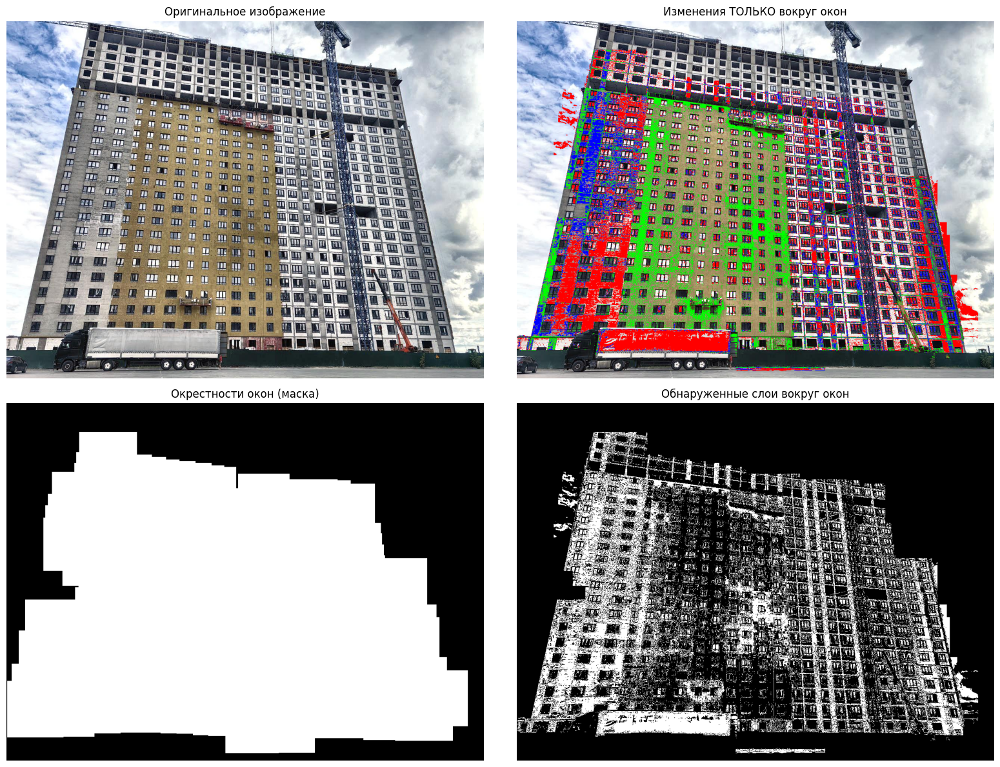

Результат визуализации сохранён: only_around_windows.jpg
Найдено 300 окон. Анализирую окрестности...

Всего обнаружено окон: 300
  - windows: 300
Обработка: /content/drive/MyDrive/datasets/photo3_2025-08-22.jpg
Results saved to output/windows
11 labels saved to output/windows/labels
Анализ слоев в порядке следования:
1. Не финишная штукатурка :
   Процент слоя: 10.49%
   Совокупный процент: 10.49%

2. утеплитель :
   Процент слоя: 13.46%
   Совокупный процент: 23.95%

3. кладка :
   Процент слоя: 21.40%
   Совокупный процент: 45.34%

Анализ слоев в порядке следования:
1. Не финишная штукатурка :
   Процент слоя: 10.49%
   Совокупный процент: 10.49%

2. утеплитель :
   Процент слоя: 13.46%
   Совокупный процент: 23.95%

3. кладка :
   Процент слоя: 21.40%
   Совокупный процент: 45.34%



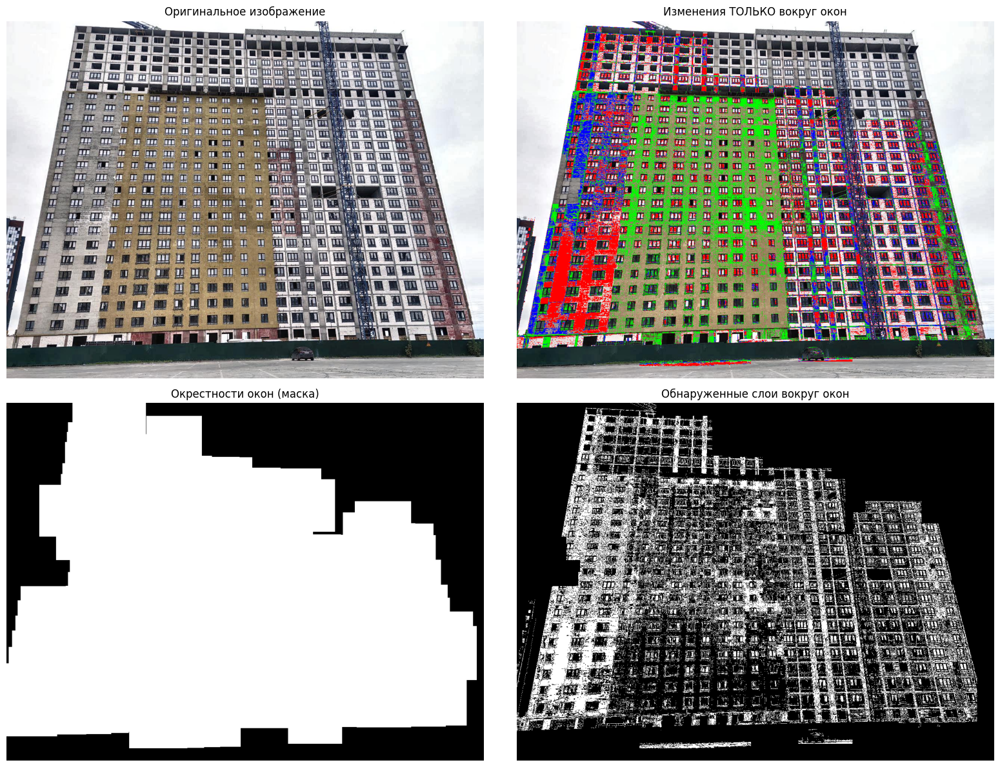

Результат визуализации сохранён: only_around_windows.jpg
Найдено 300 окон. Анализирую окрестности...

Всего обнаружено окон: 300
  - windows: 300
Обработка: /content/drive/MyDrive/datasets/photo4_2025-08-23.jpg
Results saved to output/windows
11 labels saved to output/windows/labels
Анализ слоев в порядке следования:
1. Не финишная штукатурка :
   Процент слоя: 8.90%
   Совокупный процент: 8.90%

2. утеплитель :
   Процент слоя: 15.24%
   Совокупный процент: 24.14%

3. кладка :
   Процент слоя: 16.32%
   Совокупный процент: 40.46%

Анализ слоев в порядке следования:
1. Не финишная штукатурка :
   Процент слоя: 8.90%
   Совокупный процент: 8.90%

2. утеплитель :
   Процент слоя: 15.24%
   Совокупный процент: 24.14%

3. кладка :
   Процент слоя: 16.32%
   Совокупный процент: 40.46%



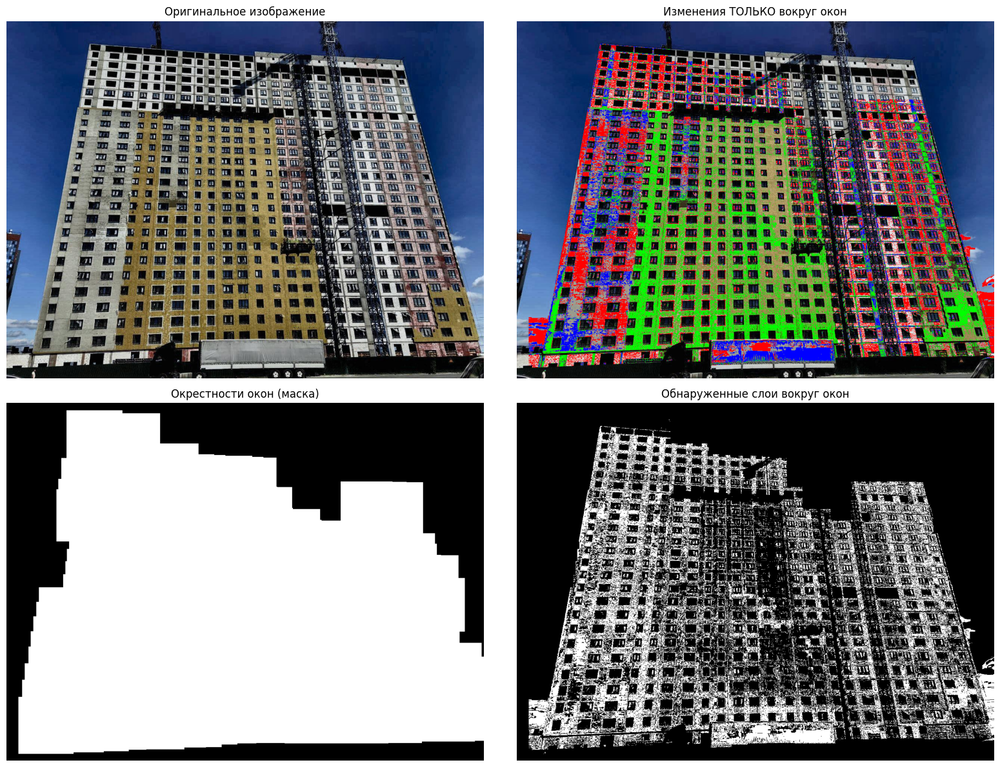

Результат визуализации сохранён: only_around_windows.jpg
Найдено 300 окон. Анализирую окрестности...

Всего обнаружено окон: 300
  - windows: 300
Обработка: /content/drive/MyDrive/datasets/photo6_2025-09-01.jpg
Results saved to output/windows
11 labels saved to output/windows/labels
Анализ слоев в порядке следования:
1. Не финишная штукатурка :
   Процент слоя: 17.74%
   Совокупный процент: 17.74%

2. утеплитель :
   Процент слоя: 13.22%
   Совокупный процент: 30.96%

3. кладка :
   Процент слоя: 30.16%
   Совокупный процент: 61.12%

Анализ слоев в порядке следования:
1. Не финишная штукатурка :
   Процент слоя: 17.74%
   Совокупный процент: 17.74%

2. утеплитель :
   Процент слоя: 13.22%
   Совокупный процент: 30.96%

3. кладка :
   Процент слоя: 30.16%
   Совокупный процент: 61.12%



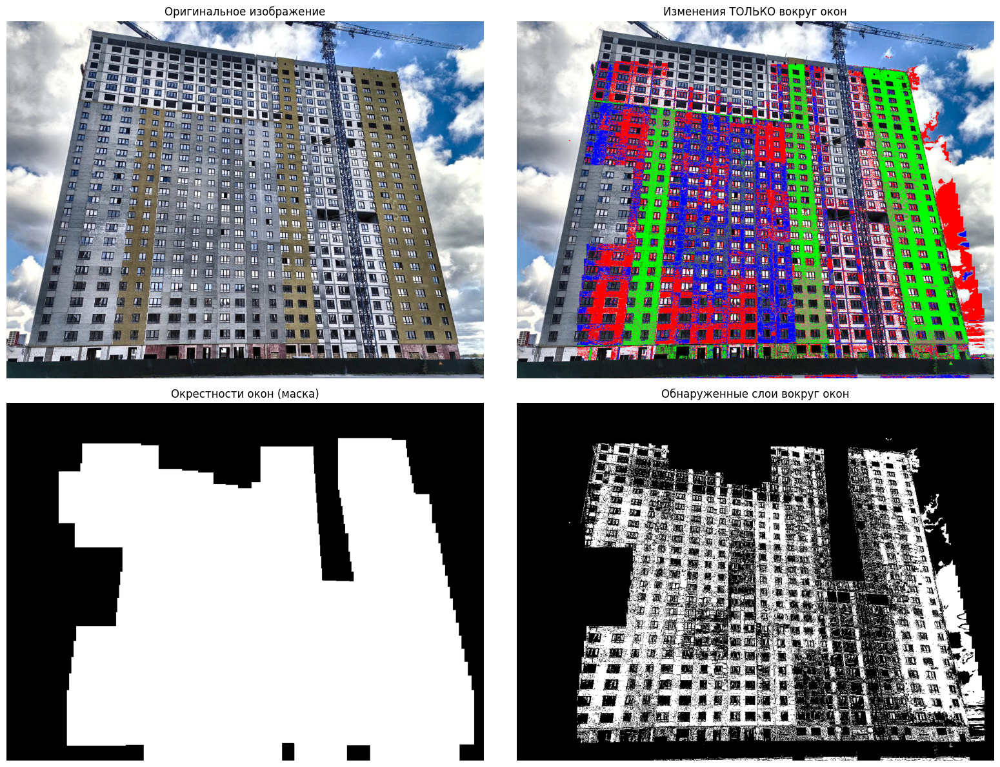

Результат визуализации сохранён: only_around_windows.jpg
Найдено 300 окон. Анализирую окрестности...

Всего обнаружено окон: 300
  - windows: 300
✅ Даты извлечены из имён файлов.

РЕЗУЛЬТАТЫ ПО ВСЕМ ИЗОБРАЖЕНИЯМ
                           image_path        image_name  num_windows                  timestamp  Не финишная штукатурка_mean_pct  Не финишная штукатурка_std_pct  утеплитель_mean_pct  утеплитель_std_pct  кладка_mean_pct  кладка_std_pct  Не финишная штукатурка_visible  утеплитель_visible  кладка_visible       date
/tmp/normalized_photo2_2025-08-14.jpg photo2_2025-08-14          300 2025-09-03 12:34:03.922882                             9.76                            9.12                20.18               12.05            20.12           13.84                            9.76               29.94           50.06 2025-08-14
/tmp/normalized_photo3_2025-08-22.jpg photo3_2025-08-22          300 2025-09-03 12:34:07.586265                             8.55                            8.02

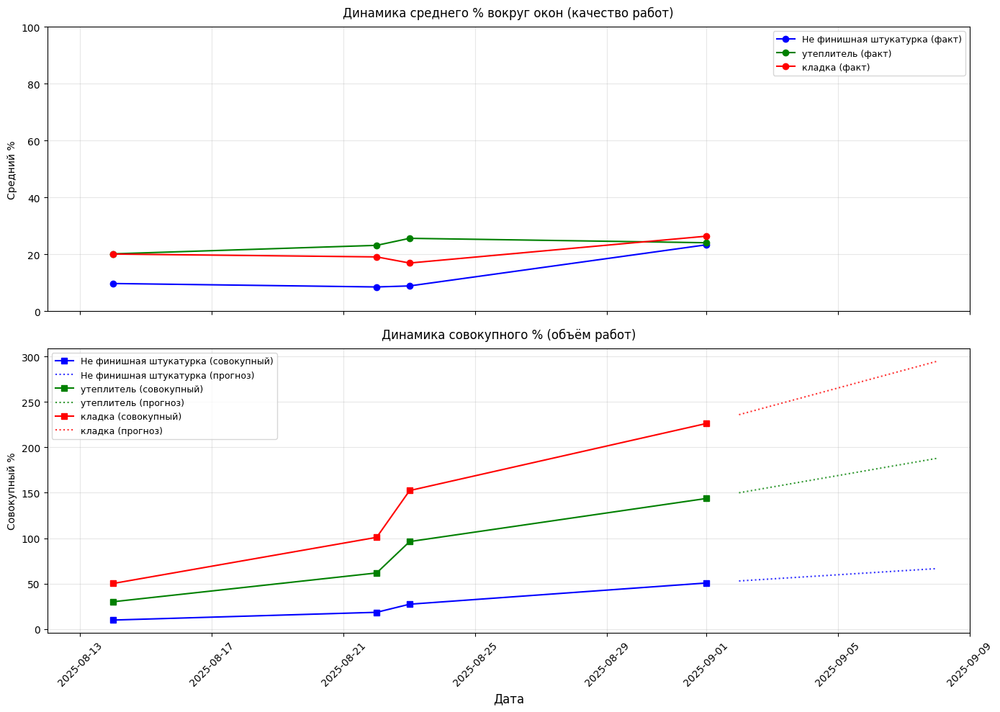


РЕЗУЛЬТАТЫ ПО ВСЕМ ИЗОБРАЖЕНИЯМ
                           image_path        image_name  num_windows                  timestamp  Не финишная штукатурка_mean_pct  Не финишная штукатурка_std_pct  утеплитель_mean_pct  утеплитель_std_pct  кладка_mean_pct  кладка_std_pct  Не финишная штукатурка_visible  утеплитель_visible  кладка_visible       date
/tmp/normalized_photo2_2025-08-14.jpg photo2_2025-08-14          300 2025-09-03 12:34:03.922882                             9.76                            9.12                20.18               12.05            20.12           13.84                            9.76               29.94           50.06 2025-08-14
/tmp/normalized_photo3_2025-08-22.jpg photo3_2025-08-22          300 2025-09-03 12:34:07.586265                             8.55                            8.02                23.17               12.48            19.11           12.95                            8.55               31.72           50.83 2025-08-22
/tmp/normalized_photo4_20

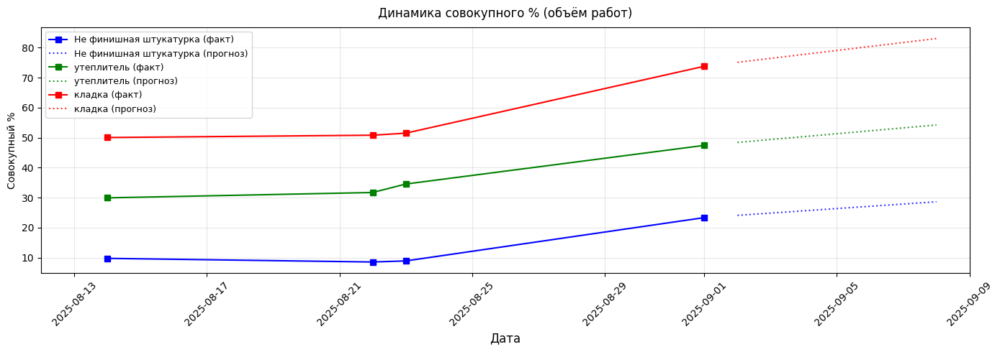


Финальные значения совокупного %:
Не финишная штукатурка: 23.35%
утеплитель: 47.44%
кладка: 73.82%


In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
from sklearn.linear_model import LinearRegression
import re

def get_file_timestamp(image_path):
    """
    Возвращает дату-время последней модификации файла
    """
    try:
        # Получаем время модификации
        mod_time = os.path.getmtime(image_path)
        return datetime.fromtimestamp(mod_time)
    except Exception as e:
        print(f"Ошибка чтения времени файла {image_path}: {e}")
        return datetime.now()  # fallback

def extract_date_from_filename(filepath):
    """
    Извлекает дату из имени файла по паттерну: YYYY-MM-DD
    Пример: photo_2024-05-15.jpg → 2024-05-15
    """
    filename = os.path.basename(filepath)
    match = re.search(r'(\d{4})[-_](\d{2})[-_](\d{2})', filename)
    if match:
        year, month, day = match.groups()
        return datetime(int(year), int(month), int(day))
    else:
        # Если не нашли — возвращаем None (чтобы потом можно было выкинуть)
        return None

def normalize_illumination(image_path, clip_limit=2.0, tile_grid_size=(8,8)):
    """
    Улучшает освещённость изображения с помощью CLAHE
    """
    # Загружаем изображение
    img = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Конвертируем в LAB — L (яркость), A и B (цвет)
    lab = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2LAB)
    l, a, b = cv2.split(lab)

    # Применяем CLAHE к каналу яркости
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    l_clahe = clahe.apply(l)

    # Собираем обратно
    lab_clahe = cv2.merge([l_clahe, a, b])
    normalized_rgb = cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2RGB)

    return normalized_rgb


def simple_white_balance(image_rgb, percentile=95):
    """
    Простая нормализация баланса белого
    """
    # Находим перцентиль яркости для каждого канала
    r, g, b = image_rgb[:,:,0], image_rgb[:,:,1], image_rgb[:,:,2]
    r_norm = r * (np.percentile(b, percentile) / np.percentile(r, percentile))
    g_norm = g * (np.percentile(b, percentile) / np.percentile(g, percentile))

    # Объединяем и ограничиваем
    balanced = np.stack([r_norm, g_norm, b], axis=2)
    balanced = np.clip(balanced, 0, 255).astype(np.uint8)
    return balanced


def process_single_image(image_path, windows_model, color_configs, padding=60, output_dir="analysis_output"):
    """
    Обрабатывает одно изображение: YOLO + анализ вокруг окон
    Возвращает: словарь с результатами
    """
    try:
        # Создаём папку для сохранения
        os.makedirs(output_dir, exist_ok=True)
        base_name = os.path.splitext(os.path.basename(image_path))[0]
        output_prefix = os.path.join(output_dir, base_name)


        # === НОВОЕ: НОРМАЛИЗАЦИЯ ИЗОБРАЖЕНИЯ ===
        img_rgb = normalize_illumination(image_path)  # Шаг 1: CLAHE
        img_rgb = simple_white_balance(img_rgb)      # Шаг 2: White Balance
        # img_rgb = color_correct_by_reference(image_path)  # Опционально
        # Сохраняем нормализованное изображение во временный файл
        temp_path = f"/tmp/normalized_{base_name}.jpg"
        Image.fromarray(img_rgb).save(temp_path)
        # === КОНЕЦ НОРМАЛИЗАЦИИ ===

        # Шаг 1: YOLO inference
        results_yolo = windows_model.predict(
            source=temp_path,
            classes=[0, 1],
            conf=0.30,
            imgsz=(960, 1280),  # можно адаптировать
            device=0,
            verbose=False
        )
        num_windows = len(results_yolo[0].boxes)

        # Шаг 2: Извлечение областей вокруг окон
        window_areas = extract_window_areas(temp_path, results_yolo, padding=padding)

        # Шаг 3: Полный анализ изображения (для масок и статистики)
        full_results = analyze_image_layers(temp_path, color_configs)

        # Шаг 4: Анализ только вокруг окон
        window_results = analyze_around_windows(temp_path, results_yolo, color_configs, padding=padding, output_prefix=output_prefix)

        # Собираем результаты
        row = {
            'image_path': temp_path,
            'image_name': base_name,
            'num_windows': num_windows,
            'timestamp': get_file_timestamp(temp_path)  # ← здесь теперь дата модификации файла
        }

        # Добавляем средние проценты по слоям
        for layer_name, stats in window_results['summary'].items():
            row[f'{layer_name}_mean_pct'] = round(stats['mean_percentage'], 2)
            row[f'{layer_name}_std_pct'] = round(stats['std_percentage'], 2)
            # row[f'{layer_name}_total_pixels'] = stats['total_count']

        # === НОВОЕ: РАСЧЁТ _visible КОЛОНКИ ПО ТВОЕЙ ФОРМУЛЕ ===
        # Порядок слоёв, как ты указал
        layers_order = [
            'Не финишная штукатурка',
            'утеплитель',
            'кладка'
        ]

        # Накопительная сумма
        cumulative_sum = 0.0

        for layer in layers_order:
            mean_col = f"{layer}_mean_pct"
            visible_col = f"{layer}_visible"

            if mean_col in row:
                # Добавляем текущий слой к накопительной сумме
                current_pct = row[mean_col]
                cumulative_sum += current_pct
                # Сохраняем накопленную сумму как _visible
                row[visible_col] = round(cumulative_sum, 2)
            else:
                # Если слой не найден, используем 0
                row[visible_col] = round(cumulative_sum, 2)

        # === КОНЕЦ ИЗМЕНЕНИЙ ===

        return row

    except Exception as e:
        print(f"Ошибка при обработке {temp_path}: {e}")
        return {
            'image_path': image_path,
            'temp_path': temp_path,
            'error': str(e)
        }



def process_image_sequence(image_paths, windows_model, color_configs, padding=60, output_dir="analysis_output"):
    """
    Обрабатывает последовательность изображений
    Возвращает DataFrame
    """
    results_list = []

    for img_path in image_paths:
        print(f"Обработка: {img_path}")
        result = process_single_image(img_path, windows_model, color_configs, padding, output_dir)
        results_list.append(result)

    # Создаём DataFrame
    df = pd.DataFrame(results_list)

    # Если есть ошибки — удаляем или помечаем
    if 'error' in df.columns:
        print("Ошибки в обработке:")
        print(df[df['error'].notna()][['image_name', 'error']])
        df = df[df['error'].isna()].drop(columns=['error'])

    df['date'] = df['image_path'].apply(extract_date_from_filename)

    # Удаляем строки без даты
    if df['date'].isna().all():
        print("⚠️ Не удалось извлечь даты из имён файлов. Используем время модификации.")
        df['date'] = df['image_path'].apply(get_file_timestamp)
    else:
        print("✅ Даты извлечены из имён файлов.")
        df = df.dropna(subset=['date'])  # удаляем, где не получилось

    df = df.sort_values('date').reset_index(drop=True)
    return df

def calculate_cumulative_percentage(df, target_layers):
    """
    Рассчитывает совокупный процент для каждого слоя
    """
    df_cumulative = df.copy()

    for layer in target_layers:
        col = f"{layer}_mean_pct"
        if col in df_cumulative.columns:
            # Рассчитываем накопленный процент (сумму по датам)
            df_cumulative[f'{layer}_cumulative_pct'] = df_cumulative[col].cumsum()
        else:
            print(f"Предупреждение: Колонка {col} не найдена в данных")

    return df_cumulative



















def plot_trends_and_forecast_cumulative(df, target_layers, forecast_days=14):
    """
    Строит графики и прогноз ТОЛЬКО по совокупному проценту для каждого слоя
    """
    # Рассчитываем совокупный процент
    df_plot = calculate_cumulative_percentage(df, target_layers)

    plt.figure(figsize=(14, 8))

    # Цвета для каждого слоя
    colors = {
        'Не финишная штукатурка': 'blue',
        'утеплитель': 'green',
        'кладка': 'red'
    }

    # Числовая ось для регрессии
    df_plot['date_num'] = np.arange(len(df_plot))

    for layer in target_layers:
        col_cumulative = f"{layer}_cumulative_pct"
        if col_cumulative not in df_plot.columns:
            print(f"Предупреждение: Совокупный процент для {layer} не найден")
            continue

        y = df_plot[col_cumulative].values
        x_numeric = df_plot['date_num'].values

        # График фактических значений совокупного процента
        plt.plot(df_plot['date'], y, 'o-',
                label=f"{layer} (совокупный %)",
                color=colors.get(layer, 'gray'),
                markersize=8)

        # Прогноз только если достаточно данных
        if len(df_plot) >= 3:
            # Линейная регрессия на совокупных значениях
            model = LinearRegression()
            X = x_numeric.reshape(-1, 1)
            model.fit(X, y)

            # Прогноз на будущие дни
            x_future = np.arange(len(df_plot), len(df_plot) + forecast_days).reshape(-1, 1)
            y_pred = model.predict(x_future)

            # Даты для прогноза
            last_date = df_plot['date'].iloc[-1]
            future_dates = [last_date + timedelta(days=i) for i in range(1, forecast_days + 1)]

            # График прогноза
            plt.plot(future_dates, y_pred, '--',
                    color=colors.get(layer),
                    alpha=0.7,
                    linewidth=2,
                    label=f"{layer} (прогноз совокупного %)")
        else:
            print(f"Недостаточно данных для прогноза {layer}")

    plt.title("Динамика совокупного процента материалов + Прогноз", fontsize=14, pad=20)
    plt.xlabel("Дата", fontsize=12)
    plt.ylabel("Совокупный % площади вокруг окон", fontsize=12)
    plt.legend(fontsize=10)
    plt.grid(True, alpha=0.3)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

    # Выводим последние значения для контроля
    print("\nПоследние значения совокупного процента:")
    for layer in target_layers:
        col_cumulative = f"{layer}_cumulative_pct"
        if col_cumulative in df_plot.columns:
            last_value = df_plot[col_cumulative].iloc[-1]
            print(f"  {layer}: {last_value:.2f}%")



def plot_trends_with_cumulative_rolling(df, target_layers, forecast_days=14, window_size=3):
    """
    Строит график по совокупному проценту с использованием скользящего среднего и прогноза
    """
    # Рассчитываем совокупный процент
    df_plot = calculate_cumulative_percentage(df, target_layers)
    df_plot = df_plot.sort_values('date').reset_index(drop=True)

    plt.figure(figsize=(14, 8))

    # Цвета для слоёв
    colors = {
        'Не финишная штукатурка': 'blue',
        'утеплитель': 'green',
        'кладка': 'red'
    }

    for layer in target_layers:
        col_cumulative = f"{layer}_cumulative_pct"
        if col_cumulative not in df_plot.columns:
            print(f"Предупреждение: {col_cumulative} не найден")
            continue

        y = df_plot[col_cumulative].values
        dates = df_plot['date'].values

        # Фактические значения (совокупный процент)
        plt.plot(dates, y, 'o-', label=f"{layer} (совокупный %)", color=colors.get(layer, 'gray'))

        # Скользящее среднее по совокупному проценту
        if len(y) >= window_size:
            rolling = pd.Series(y).rolling(window=window_size).mean().values
            plt.plot(dates, rolling, '--', color=colors.get(layer), alpha=0.8,
                     label=f"{layer} (скользящее среднее)")

            # === Прогноз на основе тренда последних точек ===
            recent_rolling = rolling[-window_size:]
            x_trend = np.arange(window_size)
            z = np.polyfit(x_trend, recent_rolling, deg=1)  # линейный тренд
            trend_line = np.poly1d(z)

            # Прогноз на будущие дни
            future_x = np.arange(window_size, window_size + forecast_days)
            y_forecast = trend_line(future_x)

            # Даты прогноза
            last_date = df_plot['date'].iloc[-1]
            future_dates = [last_date + timedelta(days=i) for i in range(1, forecast_days + 1)]

            # Построим прогноз
            plt.plot(future_dates, y_forecast, ':', color=colors.get(layer), alpha=0.9,
                     linewidth=2, label=f"{layer} (прогноз)")

            # Заливка для уверенности
            plt.fill_between(future_dates,
                           [max(0, val - 5) for val in y_forecast],
                           [val + 5 for val in y_forecast],
                           color=colors.get(layer), alpha=0.1)
        else:
            print(f"Недостаточно данных для {layer} для скользящего среднего")

    plt.title("Динамика совокупного процента материалов + Прогноз (на основе тренда)", fontsize=14, pad=20)
    plt.xlabel("Дата", fontsize=12)
    plt.ylabel("Совокупный % площади вокруг окон", fontsize=12)
    plt.legend(fontsize=10)
    plt.grid(True, alpha=0.3)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

    # Вывод последних значений
    print("\nПоследние значения совокупного процента:")
    for layer in target_layers:
        col = f"{layer}_cumulative_pct"
        if col in df_plot.columns:
            last_val = df_plot[col].iloc[-1]
            print(f"  {layer}: {last_val:.2f}%")





import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from datetime import timedelta

def plot_quality_vs_volume(df, target_layers, forecast_days=7):
    """
    Строит два графика:
    Верх: Средний % (динамика качества вокруг окон)
    Низ: Совокупный % (объём выполненных работ)
    Прогноз — нормализованный, на основе скользящего тренда
    """
    # Убедимся, что 'date' — это datetime
    df = df.copy()
    df['date'] = pd.to_datetime(df['date'])
    df = df.sort_values('date').reset_index(drop=True)

    # Рассчитываем совокупный процент
    df_cum = df.copy()
    for layer in target_layers:
        mean_col = f"{layer}_mean_pct"
        cum_col = f"{layer}_cumulative_pct"
        if mean_col in df_cum.columns:
            df_cum[cum_col] = df_cum[mean_col].cumsum()
        else:
            print(f"Столбец {mean_col} не найден")

    # Подготовка дат
    dates = df['date'].tolist()  # как список pd.Timestamp
    last_date = df['date'].iloc[-1]
    future_dates = [last_date + pd.Timedelta(days=i) for i in range(1, forecast_days + 1)]

    # Цвета
    colors = {
        'Не финишная штукатурка': 'blue',
        'утеплитель': 'green',
        'кладка': 'red'
    }

    # Создаём фигуру с двумя графиками
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 10), sharex=True)

    # === ГРАФИК 1: Средний % (качество) ===
    ax1.set_title("Динамика среднего % вокруг окон (качество работ)", fontsize=12, pad=10)
    for layer in target_layers:
        col = f"{layer}_mean_pct"
        if col not in df.columns:
            continue
        y = df[col].values

        # Нормализация для прогноза
        scaler = MinMaxScaler()
        y_scaled = scaler.fit_transform(y.reshape(-1, 1)).flatten()

        # Скользящее среднее
        window = min(3, len(y_scaled))
        rolling = pd.Series(y_scaled).rolling(window=window).mean().values

        # Прогноз
        if len(rolling) >= window:
            last_rolling = rolling[-1]
            y_forecast = np.full(forecast_days, last_rolling)
            y_forecast_raw = scaler.inverse_transform(y_forecast.reshape(-1, 1)).flatten()
        else:
            y_forecast_raw = [y[-1]] * forecast_days

        # Отрисовка
        ax1.plot(dates, y, 'o-', label=f"{layer} (факт)", color=colors.get(layer, 'gray'))
        ax1.plot(future_dates, y_forecast_raw, ':', color=colors.get(layer, 'gray'),
                 alpha=0.7, label=f"{layer} (прогноз)")

    ax1.set_ylabel("Средний %")
    ax1.legend(fontsize=9)
    ax1.grid(True, alpha=0.3)
    ax1.set_ylim(0, 100)

    # === ГРАФИК 2: Совокупный % (объём) ===
    ax2.set_title("Динамика совокупного % (объём работ)", fontsize=12, pad=10)
    for layer in target_layers:
        col = f"{layer}_cumulative_pct"
        if col not in df_cum.columns:
            continue
        y = df_cum[col].values

        # Нормализация
        scaler = MinMaxScaler()
        y_scaled = scaler.fit_transform(y.reshape(-1, 1)).flatten()

        # Скользящее среднее
        window = min(3, len(y_scaled))
        rolling = pd.Series(y_scaled).rolling(window=window).mean().values

        # Прогноз
        if len(rolling) >= window:
            last_rolling = rolling[-1]
            slope = (rolling[-1] - rolling[-window]) / window if window > 1 else 0
            y_forecast_norm = [last_rolling + slope * (i + 1) for i in range(forecast_days)]
            y_forecast_raw = scaler.inverse_transform(np.array(y_forecast_norm).reshape(-1, 1)).flatten()
            y_forecast_raw = np.maximum(y_forecast_raw, y[-1])
        else:
            y_forecast_raw = [y[-1]] * forecast_days

        # Отрисовка
        ax2.plot(dates, y, 's-', label=f"{layer} (факт)", color=colors.get(layer, 'gray'))
        ax2.plot(future_dates, y_forecast_raw, ':', color=colors.get(layer, 'gray'),
                 alpha=0.7, label=f"{layer} (прогноз)")

    ax2.set_xlabel("Дата", fontsize=12)
    ax2.set_ylabel("Совокупный %")
    ax2.legend(fontsize=9)
    ax2.grid(True, alpha=0.3)

    # Общая настройка оси X
    plt.xticks(rotation=45)
    # Используем Timestamp — можно вычитать timedelta
    plt.xlim(dates[0] - pd.Timedelta(days=2),
             future_dates[-1] + pd.Timedelta(days=1))

    plt.tight_layout()
    plt.show()

    # Выводим финальные значения
    print("\n" + "="*60)
    print("ФИНАЛЬНЫЕ ЗНАЧЕНИЯ")
    print("="*60)
    for layer in target_layers:
        mean_col = f"{layer}_mean_pct"
        cum_col = f"{layer}_cumulative_pct"
        if mean_col in df.columns and cum_col in df_cum.columns:
            mean_val = df[mean_col].iloc[-1]
            cum_val = df_cum[cum_col].iloc[-1]
            print(f"{layer}:")
            print(f"  Средний %: {mean_val:.2f}%")
            print(f"  Совокупный %: {cum_val:.2f}%")


import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from datetime import timedelta

def plot_quality_vs_volumeV2(df, target_layers, forecast_days=7, window_size=3):
    """
    Строит два графика:
    Верх: Средний % (качество вокруг окон) — прогноз на основе скользящего среднего
    Низ: Совокупный % (объём работ) — прогноз на основе скользящего среднего от совокупного %
    """
    # Убедимся, что 'date' — это datetime
    df = df.copy()
    df['date'] = pd.to_datetime(df['date'])
    df = df.sort_values('date').reset_index(drop=True)

    # Рассчитываем совокупный процент
    df_cum = df.copy()
    for layer in target_layers:
        mean_col = f"{layer}_mean_pct"
        cum_col = f"{layer}_cumulative_pct"
        if mean_col in df_cum.columns:
            df_cum[cum_col] = df_cum[mean_col].cumsum()
        else:
            print(f"Столбец {mean_col} не найден")

    # Подготовка дат
    dates = df['date'].tolist()
    last_date = df['date'].iloc[-1]
    future_dates = [last_date + pd.Timedelta(days=i) for i in range(1, forecast_days + 1)]

    # Цвета
    colors = {
        'Не финишная штукатурка': 'blue',
        'утеплитель': 'green',
        'кладка': 'red'
    }

    # Создаём фигуру с двумя графиками
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 10), sharex=True)

    # === ГРАФИК 1: Средний % (качество) ===
    ax1.set_title("Динамика среднего % вокруг окон (качество работ)", fontsize=12, pad=10)
    for layer in target_layers:
        col = f"{layer}_mean_pct"
        if col not in df.columns:
            continue
        y = df[col].values

        # Скользящее среднее по средним значениям
        if len(y) >= window_size:
            rolling_mean = pd.Series(y).rolling(window=window_size).mean().values
            ax1.plot(dates, rolling_mean, '--', alpha=0.7, color=colors.get(layer),
                     label=f"{layer} (скользящее среднее)")
        else:
            rolling_mean = y  # fallback

        # Прогноз: продолжение последнего значения скользящего среднего
        last_rolling = rolling_mean[-1]
        y_forecast = np.full(forecast_days, last_rolling)

        # Отрисовка
        ax1.plot(dates, y, 'o-', label=f"{layer} (факт)", color=colors.get(layer, 'gray'))
        ax1.plot(future_dates, y_forecast, ':', color=colors.get(layer), alpha=0.8,
                 label=f"{layer} (прогноз на MA)")

    ax1.set_ylabel("Средний %")
    ax1.legend(fontsize=9)
    ax1.grid(True, alpha=0.3)
    ax1.set_ylim(0, 100)

    # === ГРАФИК 2: Совокупный % (объём) ===
    ax2.set_title("Динамика совокупного % (объём работ)", fontsize=12, pad=10)
    for layer in target_layers:
        col = f"{layer}_cumulative_pct"
        if col not in df_cum.columns:
            continue
        y = df_cum[col].values

        # # Скользящее среднее по СОВОКУПНЫМ значениям
        # if len(y) >= window_size:
        #     rolling_cum = pd.Series(y).rolling(window=window_size).mean().values
        #     ax2.plot(dates, rolling_cum, '--', alpha=0.7, color=colors.get(layer),
        #              label=f"{layer} (скользящее среднее)")
        # else:
        #     rolling_cum = y  # fallback

        # # # Прогноз: экстраполяция на основе тренда скользящего среднего
        # if len(rolling_cum) >= window_size:
        #     # Наклон на основе последних двух точек скользящего среднего
        #     slope = (rolling_cum[-1] - rolling_cum[-2]) if len(rolling_cum) >= 2 else 0
        #     y_forecast = [rolling_cum[-1] + slope * (i + 1) for i in range(forecast_days)]
        #     # Ограничиваем рост (не может быть меньше последнего фактического)
        #     y_forecast = np.maximum(y_forecast, y[-1])
        # else:
        #     y_forecast = [y[-1]] * forecast_days


        if len(y) >= 2:
            total_growth = y[-1] - y[0]
            avg_slope = total_growth / (len(y) - 1)
            y_forecast = [y[-1] + avg_slope * (i + 1) for i in range(forecast_days)]
            y_forecast = np.clip(y_forecast, y[-1], 500)  # не больше 100, не меньше текущего
        else:
            y_forecast = [y[-1]] * forecast_days


        # Правильный расчёт наклона
        y_first = y[0]          # первое значение
        y_last = y[-1]          # последнее значение
        n_days = (dates[-1] - dates[0]).days + 1  # реальное число дней между первой и последней точкой

        if n_days > 0:
            slope = (y_last - y_first) / n_days  # % в день
        else:
            slope = 0

        # Прогноз: y(t) = y_last + slope * t
        y_forecast = [y_last + slope * i for i in range(1, forecast_days + 1)]


        # print(f"  total_growth %: {total_growth:.2f}%")
        # print(f"  avg_slope %: {avg_slope:.2f}%")
        # print(f"  forecast_days %: {forecast_days:.2f}%")
        # Отрисовка
        ax2.plot(dates, y, 's-', label=f"{layer} (факт)", color=colors.get(layer, 'gray'))
        ax2.plot(future_dates, y_forecast, ':', color=colors.get(layer), alpha=0.8,
                 label=f"{layer} (прогноз на MA)")


    # === ГРАФИК 2: Совокупный % (объём) ===
    # ax2.set_title("Динамика совокупного % (объём работ)", fontsize=12, pad=10)
    # for layer in target_layers:
    #     col = f"{layer}_cumulative_pct"
    #     if col not in df_cum.columns:
    #         continue
    #     y = df_cum[col].values

    #     # Скользящее среднее
    #     if len(y) >= window_size:
    #         rolling_cum = pd.Series(y).rolling(window=window_size).mean().values
    #         ax2.plot(dates, rolling_cum, '--', alpha=0.7, color=colors.get(layer),
    #                 label=f"{layer} (скользящее среднее)")
    #     else:
    #         rolling_cum = y

    #     # === ПРОГНОЗ: горизонтальный ===
    #     last_value = y[-1]
    #     y_forecast = [last_value] * forecast_days  # не растёт

    #     # Отрисовка
    #     ax2.plot(dates, y, 's-', label=f"{layer} (факт)", color=colors.get(layer, 'gray'))
    #     ax2.plot(future_dates, y_forecast, ':', color=colors.get(layer), alpha=0.8,
    #             label=f"{layer} (прогноз: стабилизация)")



    ax2.set_xlabel("Дата", fontsize=12)
    ax2.set_ylabel("Совокупный %")
    ax2.legend(fontsize=9)
    ax2.grid(True, alpha=0.3)

    # Общая настройка оси X
    plt.xticks(rotation=45)
    plt.xlim(dates[0] - pd.Timedelta(days=2),
             future_dates[-1] + pd.Timedelta(days=1))

    plt.tight_layout()
    plt.show()

    # Вывод финальных значений
    print("\n" + "="*60)
    print("ФИНАЛЬНЫЕ ЗНАЧЕНИЯ")
    print("="*60)
    for layer in target_layers:
        mean_col = f"{layer}_mean_pct"
        cum_col = f"{layer}_cumulative_pct"
        if mean_col in df.columns and cum_col in df_cum.columns:
            mean_val = df[mean_col].iloc[-1]
            cum_val = df_cum[cum_col].iloc[-1]
            print(f"{layer}:")
            print(f"  Средний %: {mean_val:.2f}%")
            print(f"  Совокупный %: {cum_val:.2f}%")


def plot_quality_vs_volumeV3(df, target_layers, forecast_days=7, window_size=3):
    """
    Строит два графика:
    Верх: Средний % (качество вокруг окон)
    Низ: Совокупный % (объём работ) — с правильным прогнозом
    """
    df = df.copy()
    df['date'] = pd.to_datetime(df['date'])
    df = df.sort_values('date').reset_index(drop=True)

    # Подготовка дат
    dates = df['date'].tolist()
    last_date = df['date'].iloc[-1]
    future_dates = [last_date + pd.Timedelta(days=i) for i in range(1, forecast_days + 1)]

    # Цвета
    colors = {
        'Не финишная штукатурка': 'blue',
        'утеплитель': 'green',
        'кладка': 'red'
    }

    # Создаём фигуру
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 10), sharex=True)

    # === ГРАФИК 1: Средний % (качество) ===
    ax1.set_title("Динамика среднего % вокруг окон (качество работ)", fontsize=12, pad=10)
    for layer in target_layers:
        col = f"{layer}_mean_pct"
        if col not in df.columns:
            continue
        y = df[col].values
        ax1.plot(dates, y, 'o-', label=f"{layer} (факт)", color=colors.get(layer, 'gray'))

    ax1.set_ylabel("Средний %")
    ax1.legend(fontsize=9)
    ax1.grid(True, alpha=0.3)
    ax1.set_ylim(0, 100)

    # === ГРАФИК 2: Совокупный % (объём) ===
    ax2.set_title("Динамика совокупного % (объём работ)", fontsize=12, pad=10)
    for layer in target_layers:
        col = f"{layer}_visible"  # используем пересчитанный "видимый" процент
        if col not in df.columns:
            continue
        y = df[col].values

        # Рассчитываем совокупный процент (накопленный по времени)
        cum_col = f"{layer}_cumulative_visible"
        y_cum = y.cumsum()  # например: [20, 25, 30] → [20, 45, 75]
        df[cum_col] = y_cum

        # Прогноз: наклон по первой и последней точке совокупного %
        if len(y_cum) >= 2:
            y_first = y_cum[0]
            y_last = y_cum[-1]
            n_days = (dates[-1] - dates[0]).days
            if n_days > 0:
                slope_per_day = (y_last - y_first) / n_days
            else:
                slope_per_day = 0
            y_forecast = [y_last + slope_per_day * i for i in range(1, forecast_days + 1)]
            y_forecast = np.clip(y_forecast, y_last, y_last * 2)  # ограничение
        else:
            y_forecast = [y_cum[-1]] * forecast_days

        # Отрисовка
        ax2.plot(dates, y_cum, 's-', label=f"{layer} (совокупный)", color=colors.get(layer, 'gray'))
        ax2.plot(future_dates, y_forecast, ':', color=colors.get(layer), alpha=0.8,
                 label=f"{layer} (прогноз)")

    ax2.set_xlabel("Дата", fontsize=12)
    ax2.set_ylabel("Совокупный %")
    ax2.legend(fontsize=9)
    ax2.grid(True, alpha=0.3)

    # Общая ось X
    plt.xticks(rotation=45)
    plt.xlim(dates[0] - pd.Timedelta(days=2),
             future_dates[-1] + pd.Timedelta(days=1))

    plt.tight_layout()
    plt.show()

    # Вывод
    # print("\nФинальные значения совокупного %:")
    # for layer in target_layers:
    #     cum_col = f"{layer}_cumulative_visible"
    #     if cum_col in df.columns:
    #         print(f"{layer}: {df[cum_col].iloc[-1]:.2f}%")





def plot_quality_vs_volumeV4(df, target_layers, forecast_days=7, window_size=3):
    """
    Строит два графика:
    Верх: Средний % (качество вокруг окон)
    Низ: Совокупный % (объём работ) — строится на основе колонки _visible
    """
    df = df.copy()
    df['date'] = pd.to_datetime(df['date'])
    df = df.sort_values('date').reset_index(drop=True)

    # Подготовка дат
    dates = df['date'].tolist()
    last_date = df['date'].iloc[-1]
    future_dates = [last_date + pd.Timedelta(days=i) for i in range(1, forecast_days + 1)]

    # Цвета
    colors = {
        'Не финишная штукатурка': 'blue',
        'утеплитель': 'green',
        'кладка': 'red'
    }

    # Создаём фигуру
    # fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 10), sharex=True)
    fig, ax2 = plt.subplots(1, 1, figsize=(14, 5))

    if False: # === ГРАФИК 1: Средний % (качество) ===
      ax1.set_title("Динамика среднего % вокруг окон (качество работ)", fontsize=12, pad=10)
      for layer in target_layers:
          col = f"{layer}_mean_pct"
          if col not in df.columns:
              continue
          y = df[col].values
          ax1.plot(dates, y, 'o-', label=f"{layer} (факт)", color=colors.get(layer, 'gray'))

      ax1.set_ylabel("Средний %")
      ax1.legend(fontsize=9)
      ax1.grid(True, alpha=0.3)
      ax1.set_ylim(0, 100)

    # === ГРАФИК 2: Совокупный % (объём) ===
    ax2.set_title("Динамика совокупного % (объём работ)", fontsize=12, pad=10)
    for layer in target_layers:
        col = f"{layer}_visible"  # используем пересчитанный "видимый" процент
        if col not in df.columns:
            continue
        y = df[col].values

        # Прогноз: наклон по первой и последней точке самого _visible
        if len(y) >= 2:
            y_first = y[0]
            y_last = y[-1]
            n_days = (dates[-1] - dates[0]).days
            if n_days > 0:
                slope_per_day = (y_last - y_first) / n_days
            else:
                slope_per_day = 0
            y_forecast = [y_last + slope_per_day * i for i in range(1, forecast_days + 1)]
            # Ограничиваем прогноз, чтобы не был меньше последнего значения
            y_forecast = np.clip(y_forecast, y_last, y_last * 2)
        else:
            y_forecast = [y[-1]] * forecast_days

        # Отрисовка
        ax2.plot(dates, y, 's-', label=f"{layer} (факт)", color=colors.get(layer, 'gray'))
        ax2.plot(future_dates, y_forecast, ':', color=colors.get(layer), alpha=0.8,
                 label=f"{layer} (прогноз)")

    ax2.set_xlabel("Дата", fontsize=12)
    ax2.set_ylabel("Совокупный %")
    ax2.legend(fontsize=9)
    ax2.grid(True, alpha=0.3)

    # Общая ось X
    plt.xticks(rotation=45)
    plt.xlim(dates[0] - pd.Timedelta(days=2),
             future_dates[-1] + pd.Timedelta(days=1))

    plt.tight_layout()
    plt.show()

    # Вывод финальных значений
    print("\nФинальные значения совокупного %:")
    for layer in target_layers:
        visible_col = f"{layer}_visible"
        if visible_col in df.columns:
            print(f"{layer}: {df[visible_col].iloc[-1]:.2f}%")

# === НАСТРОЙКИ ===
image_paths = [
    "/content/drive/MyDrive/datasets/photo2_2025-08-14.jpg",
    "/content/drive/MyDrive/datasets/photo3_2025-08-22.jpg",
    "/content/drive/MyDrive/datasets/photo4_2025-08-23.jpg",
    # "/content/drive/MyDrive/datasets/photo5_2025-08-29.jpg",
    "/content/drive/MyDrive/datasets/photo6_2025-09-01.jpg"
    # добавь больше
]

image_pathsB = [
    "/content/drive/MyDrive/datasets/photoB_2025-08-22.jpg",
    "/content/drive/MyDrive/datasets/photoB_2025-08-29.jpg",
    "/content/drive/MyDrive/datasets/photoB_2025-09-01.jpg"
    # добавь больше
]

color_configs = [
    {
        'color': '#7c828e',
        'tolerance': 30,
        'name': 'Не финишная штукатурка',
        'replacement_color': '#0000FF'
    },
    {
        'color': '#6d6444',
        'tolerance': 40,
        'name': 'утеплитель',
        'replacement_color': '#00FF00'
    },
    {
        'color': '#aab6c7',
        'tolerance': 50,
        'name': 'кладка',
        'replacement_color': '#FF0000'
    }
]

output_dir = "analysis_output"

# === ЗАПУСК ОБРАБОТКИ ===
# Предполагается, что windows_model уже загружен
df_results = process_image_sequence(
    image_paths=image_paths,
    windows_model=windows_model,
    color_configs=color_configs,
    padding=60,
    output_dir=output_dir
)

# === ВЫВОД ТАБЛИЦЫ ===
print("\n" + "="*80)
print("РЕЗУЛЬТАТЫ ПО ВСЕМ ИЗОБРАЖЕНИЯМ")
print("="*80)
print(df_results.to_string(index=False))

# Сохранение в CSV
df_results.to_csv("material_analysis_timeline.csv", index=False)
print(f"\nРезультаты сохранены в 'material_analysis_timeline.csv'")

# === ГРАФИКИ И ПРОГНОЗ ТОЛЬКО ПО СОВОКУПНОМУ ПРОЦЕНТУ ===
target_layers = ['Не финишная штукатурка', 'утеплитель', 'кладка']


forecast_days_Meant=17

# plot_trends_and_forecast_cumulative(
#     df=df_results,
#     target_layers=target_layers,
#     forecast_days=forecast_days_Meant
# )

# plot_trends_with_cumulative_rolling(
#     df=df_results,
#     target_layers=target_layers,
#     forecast_days=forecast_days_Meant
# )

# plot_quality_vs_volume(
#     df=df_results,
#     target_layers=target_layers,
#     forecast_days=forecast_days_Meant
# )

# plot_quality_vs_volumeV2(
#     df=df_results,
#     target_layers=target_layers,
#     forecast_days=forecast_days_Meant
# )




# === Сохраняем (опционально) ===
# df_results.to_csv("analysis_with_visible_layers.csv", index=False)



# === 4. Строим график ===
plot_quality_vs_volumeV3(
    df=df_results,
    target_layers=target_layers,
    forecast_days=7,
    window_size=3
)



# === ВЫВОД ТАБЛИЦЫ ===
print("\n" + "="*80)
print("РЕЗУЛЬТАТЫ ПО ВСЕМ ИЗОБРАЖЕНИЯМ")
print("="*80)
print(df_results.to_string(index=False))


plot_quality_vs_volumeV4(
    df=df_results,
    target_layers=target_layers,
    forecast_days=7,
    window_size=3
)

# Conclusions

- So now the model is trained and we have customized Yolo to detect PPE.
- In my [next notebook](https://www.kaggle.com/hinepo/yolov9-inference-for-red-zone-application) I will use this model to make inference on a video, and combine the PPE detection with a Red Zone application.
- **<font color='orange'>Upvote if you liked it!</font>**